# Imports

In [1]:
%%capture
!pip install wandb

In [2]:
import os, shutil, time
from google.colab import drive
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import random
from collections import defaultdict
from tqdm.notebook import tqdm
from PIL import Image
import wandb, logging

import torch, torchvision
from torch.optim import Adam
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as T, torch.nn.functional as F, torch.nn as nn

In [3]:
# Reproducibility
def set_seed(seed):
  np.random.seed(seed)
  random.seed(seed)
  torch.manual_seed(seed)
  torch.cuda.manual_seed_all(seed)

def seed_worker(worker_id):
  worker_seed = torch.initial_seed() % 2**32
  np.random.seed(worker_seed)
  random.seed(worker_seed)

In [4]:
# Constants
GDRIVE_HOME_PATH = '/content/gdrive/My Drive/Deep Learning'
GDRIVE_DATASET_PATH = f'{GDRIVE_HOME_PATH}/dataset/dataset.zip'
RESULTS_PATH = f'{GDRIVE_HOME_PATH}/results'
DATASET_BASE_PATH = '/content/dataset'
PLOTS_BASE_PATH = '/content/plots'

# Dataset

In [5]:
class Market1501Dataset(Dataset):
  def __init__(self, split, validation_split=None, transform=None, target_transform=None):
    if split not in ['train', 'validation', 'test', 'queries']:
      raise ValueError(f'Split must be either "train",  "validation", "test" or "queries". "{split}" given')

    # Load dataset in local storage
    if not os.path.exists(DATASET_BASE_PATH):
      print('Copying dataset to local storage...')
      drive.mount('/content/gdrive')
      shutil.copy(GDRIVE_DATASET_PATH, '/content/dataset.zip')
      shutil.unpack_archive("/content/dataset.zip", DATASET_BASE_PATH)
      print('Done')

    # Load image paths
    self.split = split
    self.transform = transform
    self.target_transform = target_transform
    self.img_dir = f'{DATASET_BASE_PATH}/{split if split != "validation" else "train"}'
    
    # Load labels
    if split in ['train', 'validation']:
      self.labels = pd.read_csv(f'{DATASET_BASE_PATH}/annotations_train.csv', index_col='id')
      self.labels -= 1 # Vaules from 0 instead of 1
      
      # Add multicolor column
      self.labels[['upmulticolor', 'downmulticolor']] = 0
      up_cols = ['upblack', 'upwhite', 'upred', 'uppurple', 'upyellow', 'upgray', 'upblue', 'upgreen', 'upmulticolor']
      down_cols = ['downblack', 'downwhite', 'downpink', 'downpurple', 'downyellow', 'downgray', 'downblue', 'downgreen', 'downbrown', 'downmulticolor']
      self.labels.loc[~self.labels[up_cols].any(axis=1), 'upmulticolor'] = 1
      self.labels.loc[~self.labels[down_cols].any(axis=1), 'downmulticolor'] = 1

      # Check transformation correctness
      assert np.all(self.labels[up_cols].sum(axis=1) == 1) # Must have exactly one value to 1
      assert np.all(self.labels[down_cols].sum(axis=1) == 1) # Must have exactly one value to 1
      
      # Convert to class labels
      up_cols_mapper = dict(zip(up_cols, range(len(up_cols))))
      down_cols_mapper = dict(zip(down_cols, range(len(down_cols))))
      self.labels['upcolor'] = self.labels[up_cols].rename(columns=up_cols_mapper).idxmax(axis=1)
      self.labels['downcolor'] = self.labels[down_cols].rename(columns=down_cols_mapper).idxmax(axis=1)
      self.labels.drop(columns=up_cols, inplace=True)
      self.labels.drop(columns=down_cols, inplace=True)

      # Split labels between train and validation sets
      val_size = int(len(self.labels) * validation_split)
      if split == 'validation': self.labels = self.labels.iloc[:val_size]
      elif split == 'train': self.labels = self.labels.iloc[val_size:]

    # Load images from disk
    self.data = []
    for filename in os.listdir(self.img_dir):
      img_path = f'{self.img_dir}/{filename}'
      if split in ['train', 'validation']:
        id = int(filename.split('_')[0])
        if id in self.labels.index:
          self.data.append((id, Image.open(img_path), filename)) # Add only the images present in the current split
      else:
        self.data.append((-1, Image.open(img_path), filename))
    self.data = pd.DataFrame(self.data, columns=['id', 'img', 'filename'])

    # Utility variables
    self.idx2id = self.data.id.to_dict()
    self.id2idx = self.data.reset_index().groupby('id').index.apply(list)
    self.identities = list(self.id2idx.keys())
    self.filenames = self.data.filename


  def __getitem__(self, idx): 
    id, img, _ = self.data.iloc[idx]
    label = self.labels.loc[id] if self.split in ['train', 'validation'] else pd.Series([], dtype=int)
    if self.transform:
      img = self.transform(img)
    if self.target_transform:
      label = self.target_transform(label.values)
    return (img, label, idx, id)


  def __len__(self): return len(self.data)


  @property
  def label_names(self): return self.labels.columns

In [6]:
# Custom batch sampler: randomly sample P identities and for each identity K sample. The final batch size will be therefore P * K.
# From this batch, a set of "good" triplets is computed in the loss function, i.e. triplets that provides a non-zero triplet loss.
class TripletBatchSampler():
  def __init__(self, P, K, data_source, drop_last):
    self.P = P # Number of identites
    self.K = K # Number of samples for identity
    self.batch_size = self.P * self.K
    self.data_source = data_source
    self.drop_last = drop_last

  def __iter__(self):
    batch = []
    identities = self.data_source.identities
    P_perm = random.sample(identities, len(identities)) # Random sampling of identities
    for id in P_perm:
      idx_list = self.data_source.id2idx[id]
      K_perm = random.sample(idx_list, len(idx_list)) # Random sampling of samples
      if len(K_perm) < self.K: # If the number of images is not enough, repeat the permutation
        K_perm = np.tile(K_perm, self.K//len(K_perm)+1)[:self.K]
      K_perm = K_perm[:self.K]
      for idx in K_perm:
        batch.append(idx)
      if len(batch) >= self.batch_size:
        yield batch
        batch = []
    if len(batch) > 1 and not self.drop_last:
      yield batch

  def __len__(self):
    length = len(self.data_source.identities)//self.P
    if self.drop_last: return length
    else: return length + 1

In [7]:
# Data augmentation and transformations
normalization_transform =  T.Compose([  
  T.ToTensor(),                           
  T.Normalize(mean=[0.485, 0.456, 0.406], 
              std=[0.229, 0.224, 0.225])
])

invert_normalization = T.Compose([
  T.Normalize(mean=[-0.485/0.229, -0.456/0.224, -0.406/0.225],
              std=[1/0.229, 1/0.224, 1/0.225]),
  T.ToPILImage()            
])

data_augmentation_transform = T.Compose([  
  T.RandomHorizontalFlip(p=0.5),
  #T.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1, hue=0), # do not change hue to mantain colors
  T.RandomAffine(degrees=10, translate=(0.05, 0.05)),
  normalization_transform
])

In [8]:
def get_data(validation_split, P, K, drop_last, validation_batch_size):
  transform_train = data_augmentation_transform
  transform_test = normalization_transform
  target_transform = torch.tensor
  
  # Load data
  training_data = Market1501Dataset(split='train', validation_split=validation_split, transform=transform_train, target_transform=target_transform)
  validation_data = Market1501Dataset(split='validation', validation_split=validation_split, transform=transform_test, target_transform=target_transform)
  print(f'Dataset split:')
  print(f' - Train:      {len(training_data)} ({len(training_data.identities)} identities)')
  print(f' - Validation: {len(validation_data)} ({len(validation_data.identities)} identities)\n')

  # Initialize dataloaders
  batch_sampler = TripletBatchSampler(P, K, training_data, drop_last)
  train_loader = torch.utils.data.DataLoader(training_data, batch_sampler=batch_sampler, pin_memory=True, worker_init_fn=seed_worker, num_workers=2)
  val_loader = torch.utils.data.DataLoader(validation_data, validation_batch_size, pin_memory=True, worker_init_fn=seed_worker, num_workers=2)
  return train_loader, val_loader

# Model definition

## Attribute Recognition backbone
For an independent comparison of the following three models check the notebook 'AttributeRecognition.ipynb'

### ResNet baseline

In [9]:
class ResNetBaseline(nn.Module):
  def __init__(self, hidden_size, reid_embedding_size):
    super(ResNetBaseline, self).__init__()
    # Load ResNet and change last layer
    self.resnet = torchvision.models.resnet18(pretrained=True)
    
    # Change strides of initial conv layer and maxpool to obtain larger initial feature maps
    # The resulting feature map size is the same obtained by giving in input to resnet a 256x256 image
    self.resnet.conv1.stride = (2, 1)
    self.resnet.maxpool.stride = (1, 1)

    # Change fully connected layer
    self.resnet.fc = nn.Sequential(
        nn.Linear(in_features=self.resnet.fc.in_features, out_features=hidden_size),        
    )
    # # Re-ID head
    self.reid = nn.Sequential(
      nn.BatchNorm1d(hidden_size),
      nn.LeakyReLU(),
      nn.Linear(in_features=hidden_size, out_features=reid_embedding_size)
    )

    self.age          = nn.Linear(in_features=hidden_size, out_features=4)
    self.gender       = nn.Linear(in_features=hidden_size, out_features=1)
    self.hair_length  = nn.Linear(in_features=hidden_size, out_features=1)
    self.up           = nn.Linear(in_features=hidden_size, out_features=1)
    self.down         = nn.Linear(in_features=hidden_size, out_features=1)
    self.clothes      = nn.Linear(in_features=hidden_size, out_features=1)
    self.hat          = nn.Linear(in_features=hidden_size, out_features=1)
    self.backpack     = nn.Linear(in_features=hidden_size, out_features=1)
    self.bag          = nn.Linear(in_features=hidden_size, out_features=1)
    self.handbag      = nn.Linear(in_features=hidden_size, out_features=1)
    self.upper_color  = nn.Linear(in_features=hidden_size, out_features=9)
    self.lower_color  = nn.Linear(in_features=hidden_size, out_features=10)

  def forward(self, x):
    x = self.resnet(x)
    # Re-ID embedding 
    embedding = self.reid(x)
    # Attribute recognition
    x = F.leaky_relu(x)
    age         = self.age(x)
    gender      = self.gender(x)
    hair_length = self.hair_length(x)
    up          = self.up(x)
    down        = self.down(x)
    clothes     = self.clothes(x)
    hat         = self.hat(x)
    backpack    = self.backpack(x)
    bag         = self.bag(x)
    handbag     = self.handbag (x)
    upper_color = self.upper_color(x)
    lower_color = self.lower_color(x)  

    return (
        age,
        backpack,
        bag,
        handbag,                
        clothes,
        down,
        up,
        hair_length,
        hat,
        gender,
        upper_color,
        lower_color
    ), embedding

### Convolutional Head

In [10]:
class ConvBlock(nn.Module):
  def __init__(self, in_spatial_shape, in_features, out_features_conv, out_features_linear, kernel_size):
    super(ConvBlock, self).__init__()
    self.conv    = nn.Conv2d(in_features, out_features_conv, kernel_size=kernel_size, stride=(1, 1), padding=(1, 1), bias=False)
    self.bn_conv = nn.BatchNorm2d(out_features_conv)
    self.linear  = nn.Linear(in_features=out_features_conv*in_spatial_shape[0]*in_spatial_shape[1], out_features=out_features_linear)
      
  def forward(self, x):
    x = F.leaky_relu(self.bn_conv(self.conv(x)))
    x_flattened = x.view(x.size(0), -1)
    return self.linear(x_flattened)

In [11]:
class MyNetConvHead(nn.Module):
  def __init__(self, attribute_branch_out_conv_features, hidden_size, reid_dim_embedding):
    super(MyNetConvHead, self).__init__()
    self.first_time = True

    # Load ResNet and change layer 3 in order to have larger spatial support (remove the downsampling from stride=2)
    self.resnet = torchvision.models.resnet18(pretrained=True)

    # Change strides of initial conv layer and maxpool to obtain larger initial feature maps
    # The resulting feature map size is the same obtained by giving in input to resnet a 256x256 image
    self.resnet.conv1.stride = (2, 1)
    self.resnet.maxpool.stride = (1, 1)

    # Re-ID
    hidden_size = self.resnet.fc.in_features
    self.resnet.fc = nn.Identity()
    self.reid = nn.Sequential(
      nn.Linear(in_features=hidden_size, out_features=reid_dim_embedding)
    )
    
    # Attribute recognition
    out_features, shape = attribute_branch_out_conv_features, (16, 16)
    self.age         = ConvBlock(in_spatial_shape=shape, in_features=256, out_features_conv=out_features, out_features_linear=4, kernel_size=(3,3))
    self.conv        = ConvBlock(in_spatial_shape=shape, in_features=256, out_features_conv=out_features, out_features_linear=1, kernel_size=(3,3))
    self.gender      = ConvBlock(in_spatial_shape=shape, in_features=256, out_features_conv=out_features, out_features_linear=1, kernel_size=(3,3))
    self.hair_length = ConvBlock(in_spatial_shape=shape, in_features=256, out_features_conv=out_features, out_features_linear=1, kernel_size=(3,3))
    self.up          = ConvBlock(in_spatial_shape=shape, in_features=256, out_features_conv=out_features, out_features_linear=1, kernel_size=(3,3))
    self.down        = ConvBlock(in_spatial_shape=shape, in_features=256, out_features_conv=out_features, out_features_linear=1, kernel_size=(3,3))
    self.clothes     = ConvBlock(in_spatial_shape=shape, in_features=256, out_features_conv=out_features, out_features_linear=1, kernel_size=(3,3))
    self.hat         = ConvBlock(in_spatial_shape=shape, in_features=256, out_features_conv=out_features, out_features_linear=1, kernel_size=(3,3))
    self.backpack    = ConvBlock(in_spatial_shape=shape, in_features=256, out_features_conv=out_features, out_features_linear=1, kernel_size=(3,3))
    self.bag         = ConvBlock(in_spatial_shape=shape, in_features=256, out_features_conv=out_features, out_features_linear=1, kernel_size=(3,3))
    self.handbag     = ConvBlock(in_spatial_shape=shape, in_features=256, out_features_conv=out_features, out_features_linear=1, kernel_size=(3,3))
    self.upper_color = ConvBlock(in_spatial_shape=shape, in_features=256, out_features_conv=out_features, out_features_linear=9, kernel_size=(3,3))
    self.lower_color = ConvBlock(in_spatial_shape=shape, in_features=256, out_features_conv=out_features, out_features_linear=10, kernel_size=(3,3))

    self.conv_activation = None
    def conv_activation_fhook(model, input, output): self.conv_activation = output
    self.resnet.layer3[-1].relu.register_forward_hook(conv_activation_fhook)         


  def forward(self, x):
    x = self.resnet(x)
    # Re-ID embedding 
    embedding = self.reid(x)
    # Attribute recognition
    if self.first_time:
      self.first_time=False
      print('Conv activation output shape:', self.conv_activation.shape)
    layer3  = self.conv_activation 
    age         = self.age(layer3)
    gender      = self.gender(layer3)
    hair_length = self.hair_length(layer3)
    up          = self.up(layer3)
    down        = self.down(layer3)
    clothes     = self.clothes(layer3)
    hat         = self.hat(layer3)
    backpack    = self.backpack(layer3)
    bag         = self.bag(layer3)
    handbag     = self.handbag(layer3)
    upper_color = self.upper_color(layer3)
    lower_color = self.lower_color(layer3)

    return (
        age,
        backpack,
        bag,
        handbag,                
        clothes,
        down,
        up,
        hair_length,
        hat,
        gender,
        upper_color,
        lower_color,
    ), embedding

### Self-Attention Network

In [12]:
class MyNetSelfAttention(nn.Module):
  def __init__(self, attribute_branch_out_conv_features, hidden_size, reid_dim_embedding):
    super(MyNetSelfAttention, self).__init__()
    self.first_time = True
    out_features, shape = attribute_branch_out_conv_features, (16, 16)

    self.resnet = torchvision.models.resnet18(pretrained=True)

    # Change strides of initial conv layer and maxpool to obtain larger initial feature maps
    # The resulting feature map size is the same obtained by giving in input to resnet a 256x256 image
    self.resnet.conv1.stride = (2, 1)
    self.resnet.maxpool.stride = (1, 1)
    
    self.resnet.fc = nn.Sequential(
        nn.Linear(in_features=self.resnet.fc.in_features, out_features=hidden_size)
    )

    self.age         = ConvBlock(in_spatial_shape=shape, in_features=256, out_features_conv=out_features, out_features_linear=hidden_size, kernel_size=(3,3))
    self.conv        = ConvBlock(in_spatial_shape=shape, in_features=256, out_features_conv=out_features, out_features_linear=hidden_size, kernel_size=(3,3))
    self.gender      = ConvBlock(in_spatial_shape=shape, in_features=256, out_features_conv=out_features, out_features_linear=hidden_size, kernel_size=(3,3))
    self.hair_length = ConvBlock(in_spatial_shape=shape, in_features=256, out_features_conv=out_features, out_features_linear=hidden_size, kernel_size=(3,3))
    self.up          = ConvBlock(in_spatial_shape=shape, in_features=256, out_features_conv=out_features, out_features_linear=hidden_size, kernel_size=(3,3))
    self.down        = ConvBlock(in_spatial_shape=shape, in_features=256, out_features_conv=out_features, out_features_linear=hidden_size, kernel_size=(3,3))
    self.clothes     = ConvBlock(in_spatial_shape=shape, in_features=256, out_features_conv=out_features, out_features_linear=hidden_size, kernel_size=(3,3))
    self.hat         = ConvBlock(in_spatial_shape=shape, in_features=256, out_features_conv=out_features, out_features_linear=hidden_size, kernel_size=(3,3))
    self.backpack    = ConvBlock(in_spatial_shape=shape, in_features=256, out_features_conv=out_features, out_features_linear=hidden_size, kernel_size=(3,3))
    self.bag         = ConvBlock(in_spatial_shape=shape, in_features=256, out_features_conv=out_features, out_features_linear=hidden_size, kernel_size=(3,3))
    self.handbag     = ConvBlock(in_spatial_shape=shape, in_features=256, out_features_conv=out_features, out_features_linear=hidden_size, kernel_size=(3,3))
    self.upper_color = ConvBlock(in_spatial_shape=shape, in_features=256, out_features_conv=out_features, out_features_linear=hidden_size, kernel_size=(3,3))
    self.lower_color = ConvBlock(in_spatial_shape=shape, in_features=256, out_features_conv=out_features, out_features_linear=hidden_size, kernel_size=(3,3))
    
    self.linear0  = nn.Linear(in_features=hidden_size, out_features=4)
    self.linear1  = nn.Linear(in_features=hidden_size, out_features=1)
    self.linear2  = nn.Linear(in_features=hidden_size, out_features=1)
    self.linear3  = nn.Linear(in_features=hidden_size, out_features=1)
    self.linear4  = nn.Linear(in_features=hidden_size, out_features=1)
    self.linear5  = nn.Linear(in_features=hidden_size, out_features=1)
    self.linear6  = nn.Linear(in_features=hidden_size, out_features=1)
    self.linear7  = nn.Linear(in_features=hidden_size, out_features=1)
    self.linear8  = nn.Linear(in_features=hidden_size, out_features=1)
    self.linear9  = nn.Linear(in_features=hidden_size, out_features=1)
    self.linear10 = nn.Linear(in_features=hidden_size, out_features=9)
    self.linear11 = nn.Linear(in_features=hidden_size, out_features=10)
    self.linear12 = nn.Linear(in_features=hidden_size, out_features=reid_dim_embedding) #for re-id emdedding
    
    self.norms = nn.ModuleList([nn.LayerNorm(hidden_size) for _ in range(13)])
    self.attn = nn.MultiheadAttention(embed_dim=hidden_size, num_heads=2)

    self.conv_activation = None
    def conv_activation_fhook(model, input, output): self.conv_activation = output 
    self.resnet.layer3[-1].relu.register_forward_hook(conv_activation_fhook) 


  def forward(self, x):
    emd = self.resnet(x).unsqueeze(0) 

    if self.first_time: 
      self.first_time = False
      print('Conv activation output shape:', self.conv_activation.shape)
      
    age         = self.age(self.conv_activation).unsqueeze(0)
    gender      = self.gender(self.conv_activation).unsqueeze(0)
    hair_length = self.hair_length(self.conv_activation).unsqueeze(0)
    up          = self.up(self.conv_activation).unsqueeze(0)
    down        = self.down(self.conv_activation).unsqueeze(0)
    clothes     = self.clothes(self.conv_activation).unsqueeze(0)
    hat         = self.hat(self.conv_activation).unsqueeze(0)
    backpack    = self.backpack(self.conv_activation).unsqueeze(0)
    bag         = self.bag(self.conv_activation).unsqueeze(0)
    handbag     = self.handbag(self.conv_activation).unsqueeze(0)
    upper_color = self.upper_color(self.conv_activation).unsqueeze(0)
    lower_color = self.lower_color(self.conv_activation).unsqueeze(0)
    
    # Run attention to obtain the new embeddings for each attribute as weight-sum over all the other embeddings
    # Pass the new embedding trough a dense layer for classification
    all_attr = torch.cat((age, gender, hair_length, up, down, clothes, hat, backpack, bag, handbag, upper_color, lower_color, emd), dim=0)
    new_emd = self.attn(all_attr, all_attr, all_attr)[0]
    
    age         = self.linear0(self.norms[0](new_emd[0]))
    backpack    = self.linear1(self.norms[1](new_emd[1]))
    bag         = self.linear2(self.norms[2](new_emd[2]))
    handbag     = self.linear3(self.norms[3](new_emd[3]))
    clothes     = self.linear4(self.norms[4](new_emd[4]))
    down        = self.linear5(self.norms[5](new_emd[5]))
    up          = self.linear6(self.norms[6](new_emd[6]))
    hair_length = self.linear7(self.norms[7](new_emd[7]))
    hat         = self.linear8(self.norms[8](new_emd[8]))
    gender      = self.linear9(self.norms[9](new_emd[9]))
    upper_color = self.linear10(self.norms[10](new_emd[10]))
    lower_color = self.linear11(self.norms[11](new_emd[11]))       
    emd         = self.linear12(self.norms[12](new_emd[12]))

    return (
        age,
        backpack,
        bag,
        handbag,                
        clothes,
        down,
        up,
        hair_length,
        hat,
        gender,
        upper_color,
        lower_color,
    ), emd

## Siamese network

In [13]:
class TriNet(nn.Module):
  def __init__(self, backbone, hidden_size, attribute_branch_out_conv_features, reid_dim_embedding, freeze_loss_weights):
    super(TriNet, self).__init__()
    self.reid_dim_embedding = reid_dim_embedding

    if backbone == 'selfAttention':
      self.backbone = MyNetSelfAttention(attribute_branch_out_conv_features, hidden_size, reid_dim_embedding)
    elif backbone == "convHead":
      self.backbone = MyNetConvHead(attribute_branch_out_conv_features, hidden_size, reid_dim_embedding)
    elif backbone == "resNet":
      self.backbone = ResNetBaseline(hidden_size, reid_dim_embedding)
    else:
      raise ValueError(f'Invalid network backbone "{backbone}"')
    
    # Loss weigths, trained with the model. Used to reweight the losses of the two tasks (re-ID and attribute prediction)
    self.loss_weights = nn.Parameter(torch.zeros(2), requires_grad=not freeze_loss_weights)
    
  def forward(self, x):
    attrs, embedding = self.backbone(x)
    return embedding, attrs

# Loss functions

In [14]:
# Compute pairwise distances betweeen embeddings efficently
def pairwise_dist(embeddings, squared=False):
  dot_prod = embeddings.mm(embeddings.T)
  square_norm = dot_prod.diag()
  dist = square_norm.unsqueeze(0) - 2*dot_prod + square_norm.unsqueeze(1) # Pairwise distances
  dist = dist.clamp(min=0) # Some values might be negative due to numerical instability. Set distences to >=0
  if not squared:
      mask = (dist==0).float() # 1 in the positions where dist==0, otherwise 0
      dist = dist + 1e-16 * mask  # Because the gradient of sqrt is infinite when dist==0, add a small epsilon where dist==0
      dist = torch.sqrt(dist)
      dist = dist * (1 - mask) # Correct the epsilon added: set the distances on the mask to be 0
  return dist

In [15]:
# Re-ID loss
class ReIDLoss():
  def __init__(self, margin, squared=False):
    self.margin = margin 
    self.squared = squared

  def __call__(self, embeddings, identities):
    dist = pairwise_dist(embeddings, self.squared)
    anchor_positive_dist, anchor_negative_dist = dist.unsqueeze(2), dist.unsqueeze(1)
    triplet_loss = anchor_positive_dist - anchor_negative_dist + self.margin
    mask = self.get_valid_triplets_mask(identities)  # 3D mask to filter out invalid triplets
    triplet_loss = torch.clamp(triplet_loss * mask.float(), min=0)
    num_positive_triplets = (triplet_loss > 0).float().sum()
    triplet_loss = triplet_loss.sum() / (num_positive_triplets + 1e-16)
    return triplet_loss

  # Generate a binary mask for the valid triplets, i.e. the triplets that contains positive_id==anchor_id, negative_id!=anchor_id and anchor_img!=positive_img!=negative_img
  # Implementation taken from https://github.com/Yuol96/pytorch-triplet-loss/blob/master/model/triplet_loss.py
  def get_valid_triplets_mask(self, identities):
    indices_equal = torch.eye(identities.size(0), device=identities.device).byte()
    indices_not_equal = ~indices_equal
    i_ne_j = indices_not_equal.unsqueeze(2)
    i_ne_k = indices_not_equal.unsqueeze(1)
    j_ne_k = indices_not_equal.unsqueeze(0)
    distinct_indices = i_ne_j & i_ne_k & j_ne_k
    identities_equal = torch.eq(identities.unsqueeze(1), identities.unsqueeze(0))
    i_eq_j = identities_equal.unsqueeze(2)
    i_eq_k = identities_equal.unsqueeze(1)
    i_ne_k = ~i_eq_k
    valid_identities = i_eq_j & i_ne_k
    mask = distinct_indices & valid_identities
    return mask


# Attribute recognition loss
class AttributeRecognitionLoss():
  def __init__(self):
    self.CEloss = nn.CrossEntropyLoss()
    self.BCEloss = nn.BCEWithLogitsLoss()
  
  def __call__(self, outputs, targets):
    loss = self.CEloss(outputs[0], targets[:, 0]) # Age
    for i in range(1, 9+1): # Binary variables
      loss += self.BCEloss(outputs[i].squeeze(), targets[:, i].float())
    loss += self.CEloss(outputs[10], targets[:, 10]) # Upcolor
    loss += self.CEloss(outputs[11], targets[:, 11]) # Downcolor
    return loss/12 # Compute average across losses


# Multi-task loss
class MultiTaskLoss():
  def __init__(self, model, margin):
    self.model = model
    self.reid_loss = ReIDLoss(margin)
    self.attr_loss = AttributeRecognitionLoss()

  def __call__(self, embeddings, identities, attr_outs, attr_targets):
    reid_loss = self.reid_loss(embeddings, identities)
    attr_loss = self.attr_loss(attr_outs, attr_targets)
    # Re-weight the losses according to the model's parameters (see https://arxiv.org/pdf/1705.07115)
    is_reid = torch.tensor([True, False], dtype=float, device=reid_loss.device)
    stds = self.model.loss_weights.exp()
    coeffs =  1 / ((is_reid+1) * stds**2)
    reid_loss = reid_loss * coeffs[0] + stds[0].log()
    attr_loss = attr_loss * coeffs[1] + stds[1].log()
    return reid_loss + attr_loss

# Accuracy functions

In [16]:
def attr_accuracy_function(outputs, targets):
  age_acc = outputs[0].argmax(1).eq(targets[:, 0]).unsqueeze(1)
  bec_acc = torch.sigmoid(torch.cat([e for e in outputs[1:10]], dim=1)).round().eq(targets[:, 1:10])
  up_acc = outputs[10].argmax(1).eq(targets[:, 10]).unsqueeze(1)
  down_acc = outputs[11].argmax(1).eq(targets[:, 11]).unsqueeze(1)
  return torch.cat([age_acc, bec_acc, up_acc, down_acc], 1)

In [17]:
from typing import Dict, Set, List

def evaluate_map(predictions: Dict[str, List], ground_truth: Dict[str, Set]):
  '''
  Computes the mAP (https://jonathan-hui.medium.com/map-mean-average-precision-for-object-detection-45c121a31173) of the predictions with respect to the given ground truth
  In person reidentification mAP refers to the mean of the AP over all queries.
  The AP for a query is the area under the precision-recall curve obtained from the list of predictions considering the
  ground truth elements as positives and the other ones as negatives

  :param predictions: dictionary from query filename to list of test image filenames associated with the query ordered
                      from the most to the least confident prediction.
                      Represents the predictions to be evaluated.
  :param ground_truth: dictionary from query filename to set of test image filenames associated with the query
                        Represents the ground truth on which to evaluate predictions.

  :return:
  '''
  pl = [len(s) for q, s in predictions.items()]
  tl = [len(s) for q, s in ground_truth.items()]
  #print(f"Average pred: {sum(pl) / len(pl)}, average ground_truth: {sum(tl) / len(tl)}")
  #print(f"min pred: {min(pl)}, min ground_truth: {min(tl)}")
  #print(f"max pred: {max(pl)}, max ground_truth: {max(tl)}")
  m_ap = 0.0
  for current_ground_truth_query, current_ground_truth_query_set in ground_truth.items():

    # No predictions were performed for the current query, AP = 0
    if not current_ground_truth_query in predictions:
      continue

    current_ap = 0.0  # The area under the curve for the current sample
    current_predictions_list = predictions[current_ground_truth_query]

    # Recall increments of this quantity each time a new correct prediction is encountered in the prediction list
    delta_recall = 1.0 / len(current_ground_truth_query_set)

    # Goes through the list of predictions
    encountered_positives = 0
    for idx, current_prediction in enumerate(current_predictions_list):
      # Each time a positive is encountered, compute the current precition and the area under the curve
      # since the last positive
      if current_prediction in current_ground_truth_query_set:
        encountered_positives += 1
        current_precision = encountered_positives / (idx + 1)
        current_ap += current_precision * delta_recall

    m_ap += current_ap

  # Compute mean over all queries
  m_ap /= len(ground_truth)

  return m_ap

# Train and test

In [18]:
def _train_test(train, model, data_loader, loss_function, optimizer, device):
  if train: model.train()
  else: model.eval()

  dataset = data_loader.dataset
  n_samples = 0
  cumulative_loss, cumulative_accuracy = .0, .0
  computed_embeddings = torch.zeros(len(dataset), model.reid_dim_embedding, device=device, dtype=torch.float)

  with torch.set_grad_enabled(train):
    for batch_idx, (inputs, attr_targets, idx, identities) in enumerate(tqdm(data_loader, desc='Training' if train else 'Testing')):
    
      # Move data to GPU
      inputs, attr_targets = inputs.to(device, non_blocking=True), attr_targets.to(device, non_blocking=True)
      idx, identities = idx.to(device, non_blocking=True), identities.to(device, non_blocking=True)
  
      # Forward pass
      embeddings, attr_outs = model(inputs) 

      # Compute loss
      loss = loss_function(embeddings, identities, attr_outs, attr_targets)

      # Backprogate the loss
      if train:
        loss.backward() # Backward pass
        optimizer.step() # Update parameters
        optimizer.zero_grad() # Resets the gradients

      # Compute cumulative loss and accuracy
      n_samples += inputs.shape[0]
      cumulative_loss += loss.detach()
      cumulative_accuracy += attr_accuracy_function(attr_outs, attr_targets).sum(0).detach()

      # Save computed embeddings for each sample
      computed_embeddings[idx] = embeddings.detach()

  # Compute re-ID mAP
  map = 0
  if not train:
    # Compute pairwise distances
    dist = pairwise_dist(computed_embeddings)
    # Compute ground truth dict
    ground_truth = { idx: set(dataset.id2idx[id]) - set([idx]) for idx, id in dataset.idx2id.items() }
    # Compute predictions dict
    sorted_dist = dist.sort(dim=1).indices
    predictions = { idx: idx_preds.tolist() for idx, idx_preds in enumerate(sorted_dist) }
    for idx in predictions: predictions[idx].remove(idx)
    # Compute map
    map = evaluate_map(predictions, ground_truth)
    # Print result w.r.t. a sample
    for idx in [2]:
      image, attr, _, id = dataset[idx]
      print(f'\nSample #{idx} (ID: {id})')
      idx_truth, idx_pred = list(ground_truth[idx]), list(predictions[idx])
      dtot, idx_dtot = dist[idx].sort()
      dtruth, dpred = dist[idx][idx_truth], dist[idx][idx_pred]
      print(f'Ground truth distances: min={dtruth.min():.2f}, mean={dtruth.mean():.2f}, max={dtruth.max():.2f}')
      print(f'Predictions distances:  min={dpred.min():.2f}, mean={dpred.mean():.2f}, max={dpred.max():.2f}')
      query_img = invert_normalization(image).convert("RGB")
      query_img.save(f'{PLOTS_BASE_PATH}/reid_query.jpg')
      display(query_img)
      print('Ground truth')
      truth_imgs = invert_normalization(torch.cat([dataset[idx][0] for idx in idx_truth], dim=2)).convert("RGB")
      truth_imgs.save(f'{PLOTS_BASE_PATH}/reid_truth.jpg')
      display(truth_imgs)
      print('Best predictions')
      pred_imgs = invert_normalization(torch.cat([dataset[idx][0] for idx in idx_pred[:len(idx_truth)]], dim=2)).convert("RGB")
      pred_imgs.save(f'{PLOTS_BASE_PATH}/reid_predictions.jpg')
      display(pred_imgs)
      print(f'Distance values distribution for sample #{idx}')
      truth_x = (idx_dtot[..., None] == torch.tensor(idx_truth, device=idx_dtot.device)).any(-1).nonzero().flatten().cpu().numpy() # Sorted position of ground truth samples
      truth_y = dtot[truth_x].cpu().numpy()
      dtot = dtot.cpu().numpy()
      fig, axs = plt.subplots(1, 2, figsize=(10, 4))
      axs[0].plot(range(len(dtot[1:150])), dtot[1:150], zorder=1)
      axs[0].axvline(len(ground_truth[idx]), c='k', linestyle='--')
      axs[0].scatter(truth_x[truth_x < 150] - 1, truth_y[truth_x < 150], c='r', alpha=1, s=15, marker='o', zorder=2)
      axs[0].set_ylabel('Distance')
      axs[1].plot(range(len(dtot[1:])), dtot[1:], zorder=1)
      axs[1].scatter(truth_x - 1, truth_y, c='r', alpha=1, s=15, marker='o', zorder=2)
      plt.tight_layout()
      plt.savefig(f'{PLOTS_BASE_PATH}/distances.jpg', dpi=200, bboc_inches='tight')
      plt.show()

  loss = cumulative_loss.item()/n_samples
  attr_accuracy = cumulative_accuracy/n_samples
  tot_attr_accuracy = cumulative_accuracy.sum()/(n_samples*cumulative_accuracy.shape[0]) # n_samples * n_attributes
  return loss, tot_attr_accuracy*100, attr_accuracy*100, map*100

def train(net, data_loader, loss_function, optimizer, device, **args): return _train_test(True, net, data_loader, loss_function, optimizer, device, **args)
def test(net, data_loader, loss_function, device, **args): return _train_test(False, net, data_loader, loss_function, None, device, **args)

# Run

In [19]:
def write_result(kind, epoch, loss, attr_acc, reid_map=None, loss_weights=None):
  print(f'{kind.upper():>10} loss: {loss:.6f}, AR accuracy: {attr_acc:.2f}%{f", re-ID mAP: {reid_map:.2f}%" if reid_map else ""}')
  if epoch is not None:
    log = {kind: {'loss': loss, 'ar_accuracy': attr_acc}}
    if reid_map is not None: 
      log[kind]['reid_map'] = reid_map
    if loss_weights is not None: 
      log['reid_weight'] = loss_weights[0].item()
      log['ar_weight'] = loss_weights[1].item()
    wandb.log(log)

In [20]:
def main(exp_id, epochs, P, K, model_params, optimizer_params, loss_params, device, disable_wandb):
  os.makedirs(PLOTS_BASE_PATH, exist_ok=True)
  torch.cuda.empty_cache()
  
  # Instantiates dataloaders
  train_loader, val_loader = get_data(validation_split=0.3, P=P, K=K, drop_last=True, validation_batch_size=256)

  # Instantiates the model
  model = TriNet(**model_params).to(device)
  
  # Instantiates the optimizer
  optimizer = Adam(model.parameters(), **optimizer_params)
  
  # Instantiates the loss function
  loss_function = MultiTaskLoss(model, **loss_params)
  
  # Init wandb
  run = wandb.init(
    project='ARN',
    group=exp_id,
    entity='materigh',
    reinit=True,
    config=dict(epochs=epochs, P=P, K=K, **model_params, **optimizer_params, **loss_params),
    mode='disabled' if disable_wandb else 'online'
  )
  wandb.watch(model)

  # Start training
  for e in range(1, epochs+1):
    print(f'\nEpoch {e}:')
    train_loss, tot_train_attr_accuracy, train_attr_accuracy, _ = train(model, train_loader, loss_function, optimizer, device)
    val_loss, tot_val_attr_accuracy, val_attr_accuracy, val_reid_map = test(model, val_loader, loss_function, device)
    print('loss weights:', model.loss_weights.data)
    print()
    write_result('train', e, train_loss, tot_train_attr_accuracy, loss_weights=model.loss_weights.data)
    write_result('validation', e, val_loss, tot_val_attr_accuracy, reid_map=val_reid_map)
    print('---------------------------------------------------------------------')

  # Report performances after training
  print('\nValidation accuracy by label:')
  val_attr_accuracy = pd.Series(val_attr_accuracy.detach().cpu().numpy(), index=train_loader.dataset.label_names)
  val_attr_accuracy['avg'] = val_attr_accuracy.mean()
  print(val_attr_accuracy.round(2).astype(str)+'%')
    
  # Close wandb logger
  run.finish()

  # Return the final model
  return model

Running on device "cuda"

Copying dataset to local storage...
Mounted at /content/gdrive
Done
Dataset split:
 - Train:      8801 (526 identities)
 - Validation: 4188 (225 identities)



Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth


  0%|          | 0.00/44.7M [00:00<?, ?B/s]


Epoch 1:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=2.17, mean=3.54, max=5.33
Predictions distances:  min=2.17, mean=7.26, max=15.13


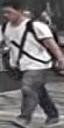

Ground truth


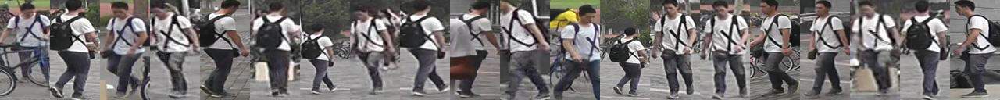

Best predictions


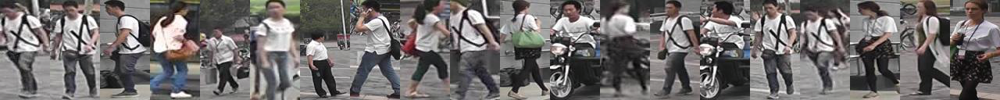

Distance values distribution for sample #2


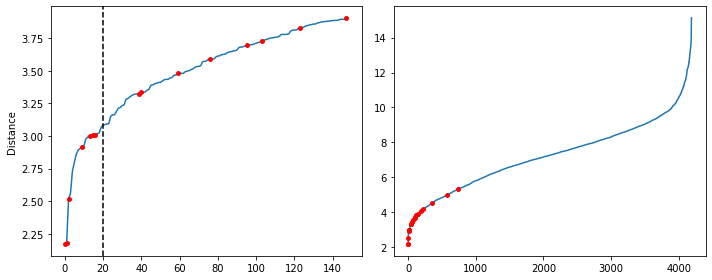

loss weights: tensor([-0.0029,  0.0040], device='cuda:0')

     TRAIN loss: 0.003698, AR accuracy: 67.58%
VALIDATION loss: 0.005072, AR accuracy: 71.72%, re-ID mAP: 35.28%
---------------------------------------------------------------------

Epoch 2:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.56, mean=2.95, max=4.34
Predictions distances:  min=1.56, mean=7.96, max=16.50


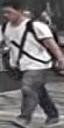

Ground truth


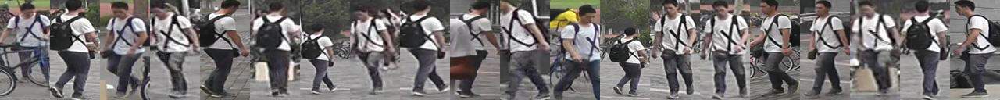

Best predictions


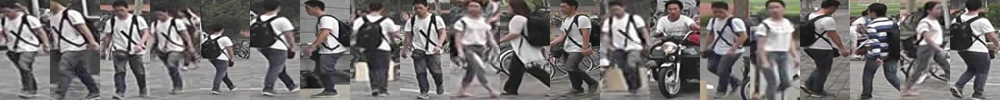

Distance values distribution for sample #2


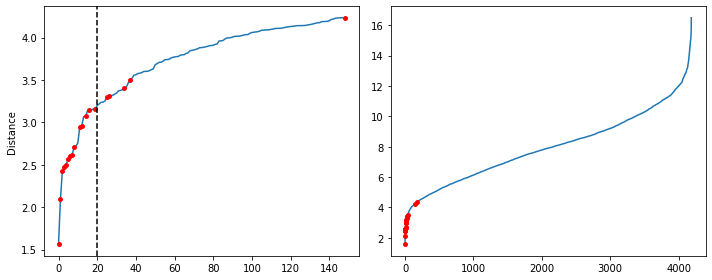

loss weights: tensor([-0.0039,  0.0072], device='cuda:0')

     TRAIN loss: 0.003353, AR accuracy: 74.15%
VALIDATION loss: 0.004615, AR accuracy: 75.56%, re-ID mAP: 45.39%
---------------------------------------------------------------------

Epoch 3:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.72, mean=3.00, max=6.64
Predictions distances:  min=1.72, mean=8.59, max=14.16


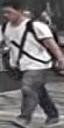

Ground truth


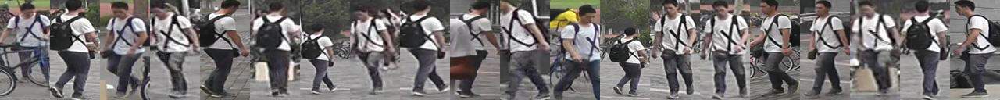

Best predictions


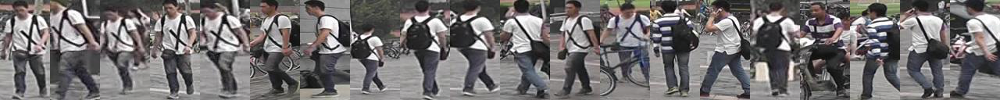

Distance values distribution for sample #2


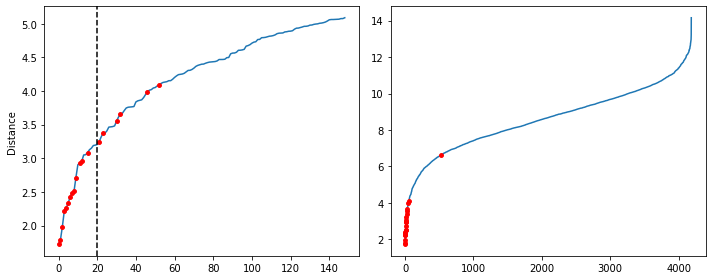

loss weights: tensor([-0.0063,  0.0097], device='cuda:0')

     TRAIN loss: 0.003075, AR accuracy: 76.76%
VALIDATION loss: 0.004406, AR accuracy: 77.11%, re-ID mAP: 51.22%
---------------------------------------------------------------------

Epoch 4:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.50, mean=3.25, max=6.01
Predictions distances:  min=1.50, mean=8.81, max=13.20


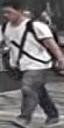

Ground truth


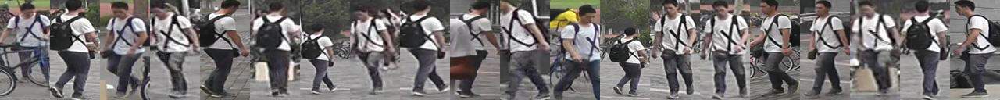

Best predictions


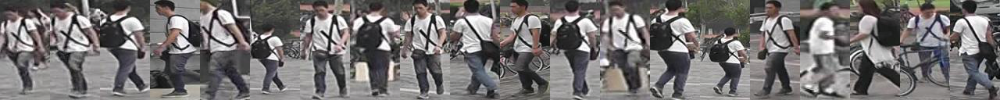

Distance values distribution for sample #2


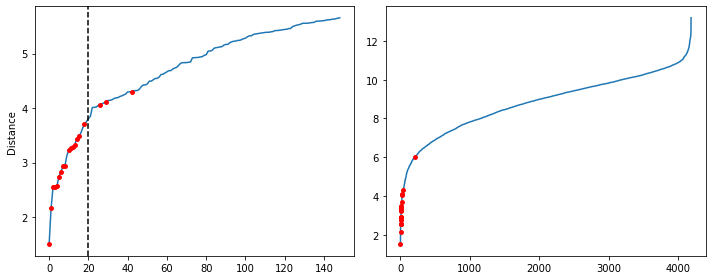

loss weights: tensor([-0.0105,  0.0117], device='cuda:0')

     TRAIN loss: 0.002864, AR accuracy: 77.79%
VALIDATION loss: 0.004301, AR accuracy: 78.59%, re-ID mAP: 56.15%
---------------------------------------------------------------------

Epoch 5:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.89, mean=3.84, max=7.28
Predictions distances:  min=1.89, mean=10.16, max=15.09


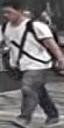

Ground truth


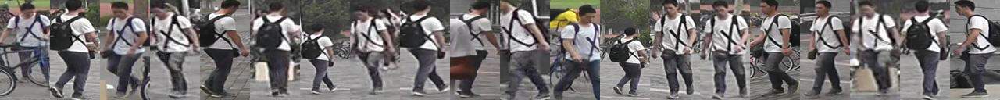

Best predictions


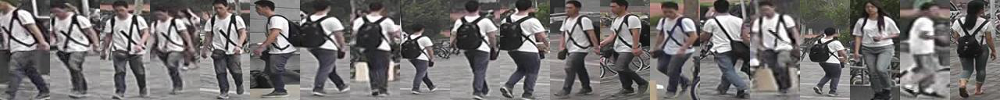

Distance values distribution for sample #2


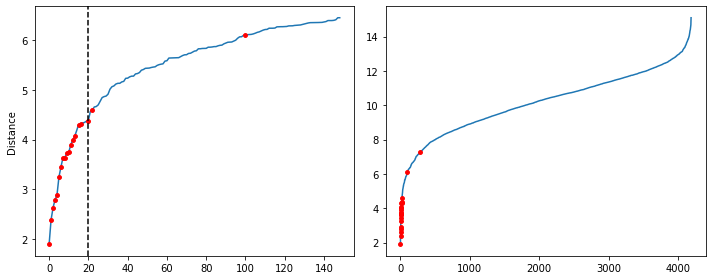

loss weights: tensor([-0.0151,  0.0130], device='cuda:0')

     TRAIN loss: 0.002838, AR accuracy: 79.11%
VALIDATION loss: 0.004468, AR accuracy: 79.27%, re-ID mAP: 56.20%
---------------------------------------------------------------------

Epoch 6:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.22, mean=3.39, max=5.11
Predictions distances:  min=1.22, mean=9.61, max=13.77


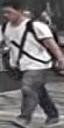

Ground truth


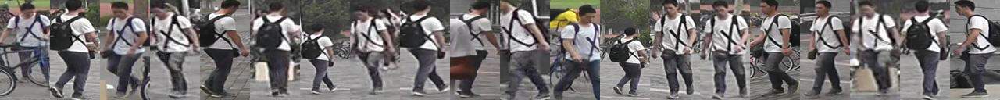

Best predictions


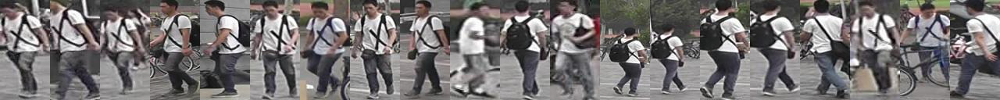

Distance values distribution for sample #2


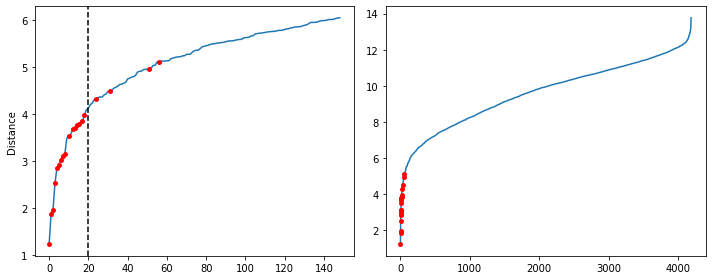

loss weights: tensor([-0.0195,  0.0137], device='cuda:0')

     TRAIN loss: 0.002693, AR accuracy: 80.09%
VALIDATION loss: 0.004232, AR accuracy: 80.37%, re-ID mAP: 58.81%
---------------------------------------------------------------------

Epoch 7:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.58, mean=3.49, max=5.56
Predictions distances:  min=1.58, mean=9.34, max=13.29


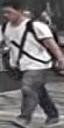

Ground truth


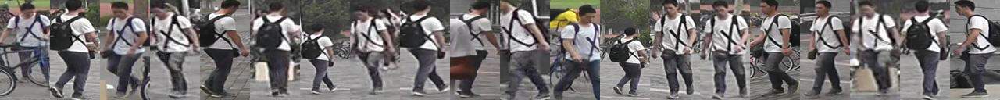

Best predictions


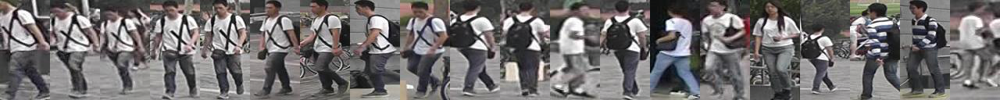

Distance values distribution for sample #2


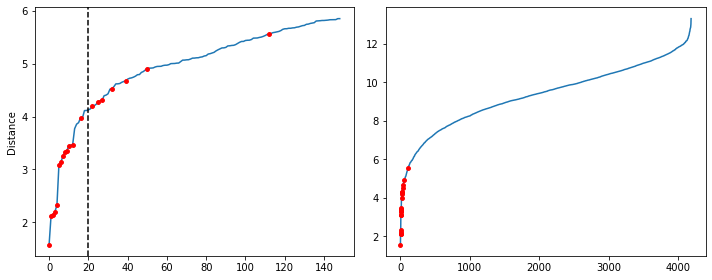

loss weights: tensor([-0.0247,  0.0139], device='cuda:0')

     TRAIN loss: 0.002610, AR accuracy: 80.68%
VALIDATION loss: 0.004311, AR accuracy: 80.89%, re-ID mAP: 59.46%
---------------------------------------------------------------------

Epoch 8:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.62, mean=3.91, max=7.88
Predictions distances:  min=1.62, mean=9.80, max=14.31


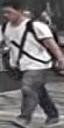

Ground truth


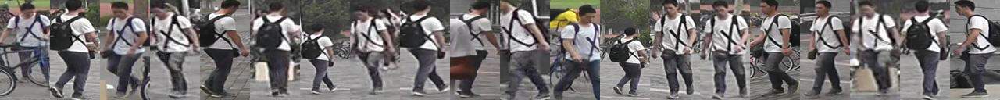

Best predictions


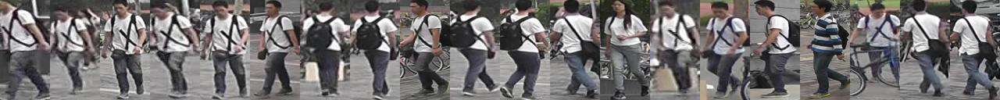

Distance values distribution for sample #2


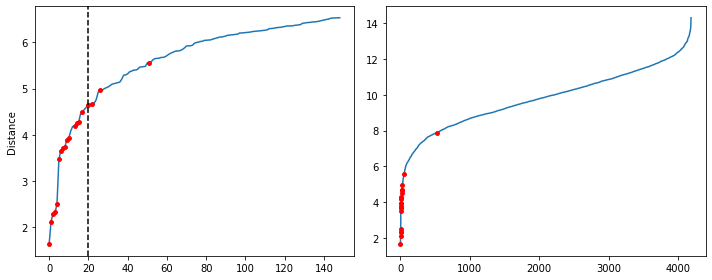

loss weights: tensor([-0.0299,  0.0134], device='cuda:0')

     TRAIN loss: 0.002514, AR accuracy: 81.73%
VALIDATION loss: 0.004222, AR accuracy: 81.21%, re-ID mAP: 57.98%
---------------------------------------------------------------------

Epoch 9:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.29, mean=3.29, max=5.40
Predictions distances:  min=1.29, mean=11.52, max=18.00


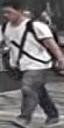

Ground truth


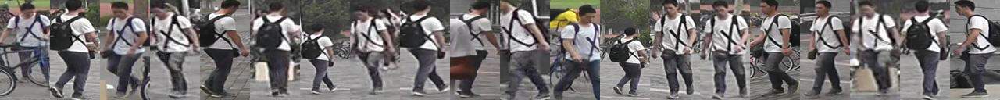

Best predictions


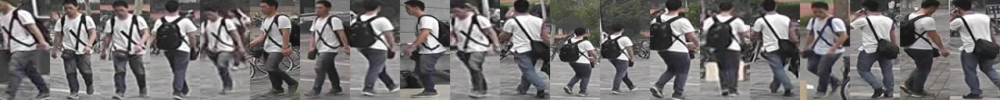

Distance values distribution for sample #2


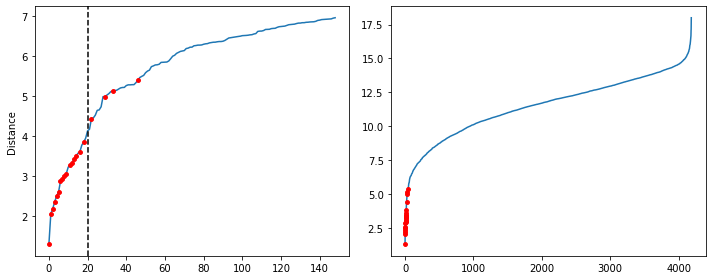

loss weights: tensor([-0.0342,  0.0123], device='cuda:0')

     TRAIN loss: 0.002524, AR accuracy: 81.92%
VALIDATION loss: 0.004425, AR accuracy: 80.25%, re-ID mAP: 60.63%
---------------------------------------------------------------------

Epoch 10:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.42, mean=3.76, max=6.66
Predictions distances:  min=1.42, mean=10.63, max=16.79


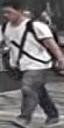

Ground truth


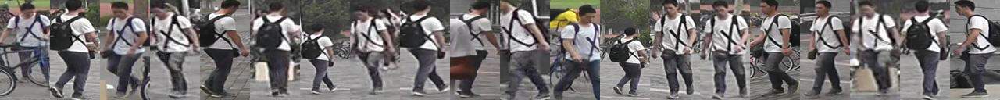

Best predictions


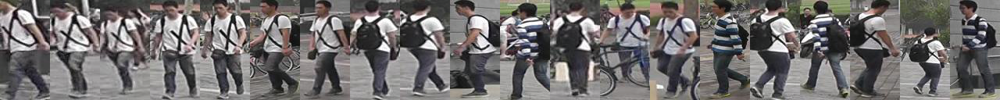

Distance values distribution for sample #2


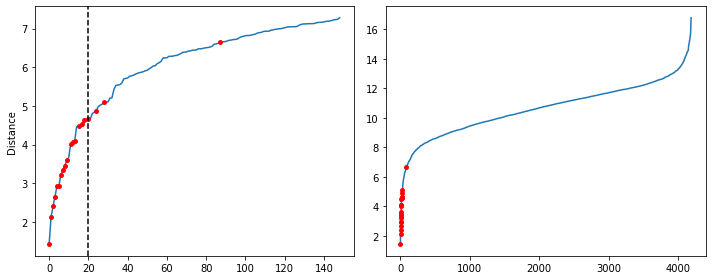

loss weights: tensor([-0.0385,  0.0106], device='cuda:0')

     TRAIN loss: 0.002502, AR accuracy: 82.87%
VALIDATION loss: 0.004110, AR accuracy: 81.64%, re-ID mAP: 62.17%
---------------------------------------------------------------------

Epoch 11:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.62, mean=3.71, max=6.22
Predictions distances:  min=1.62, mean=10.43, max=15.57


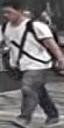

Ground truth


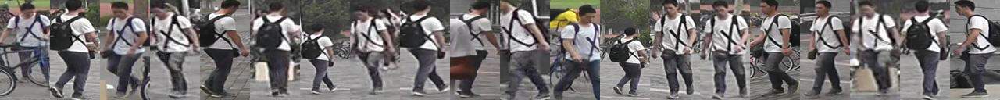

Best predictions


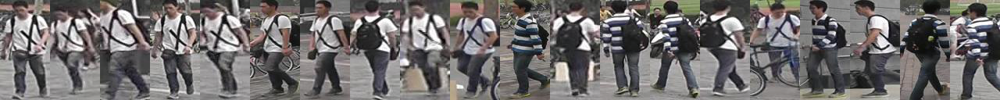

Distance values distribution for sample #2


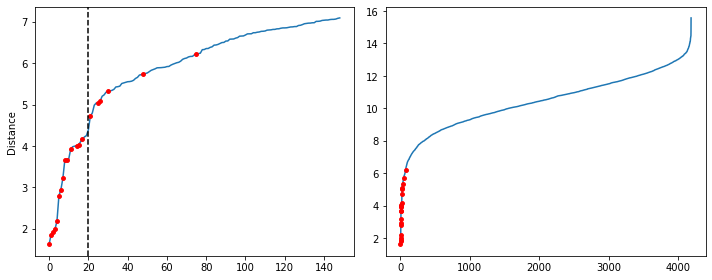

loss weights: tensor([-0.0423,  0.0086], device='cuda:0')

     TRAIN loss: 0.002458, AR accuracy: 82.73%
VALIDATION loss: 0.004155, AR accuracy: 81.62%, re-ID mAP: 60.79%
---------------------------------------------------------------------

Epoch 12:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.68, mean=3.82, max=5.74
Predictions distances:  min=1.68, mean=10.17, max=14.25


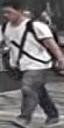

Ground truth


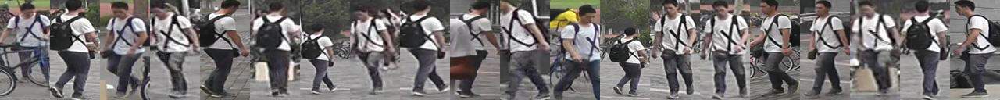

Best predictions


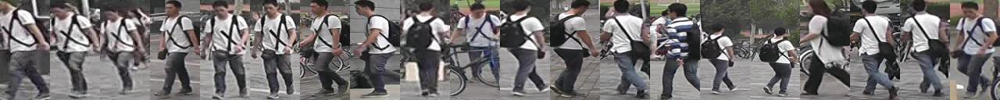

Distance values distribution for sample #2


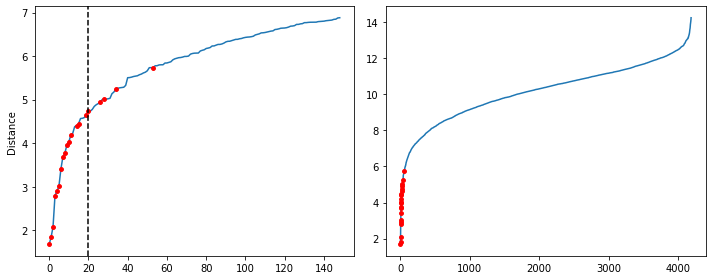

loss weights: tensor([-0.0451,  0.0062], device='cuda:0')

     TRAIN loss: 0.002494, AR accuracy: 82.96%
VALIDATION loss: 0.004093, AR accuracy: 82.12%, re-ID mAP: 63.46%
---------------------------------------------------------------------

Epoch 13:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.67, mean=3.81, max=5.57
Predictions distances:  min=1.67, mean=10.21, max=15.39


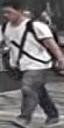

Ground truth


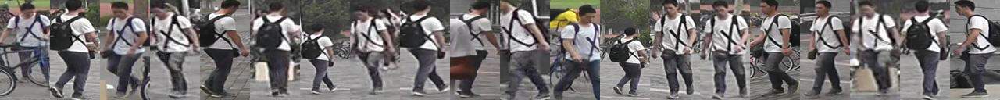

Best predictions


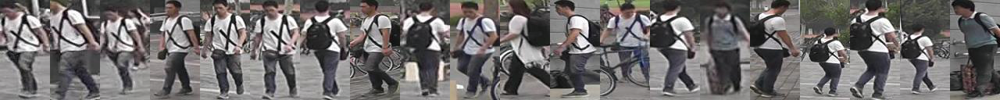

Distance values distribution for sample #2


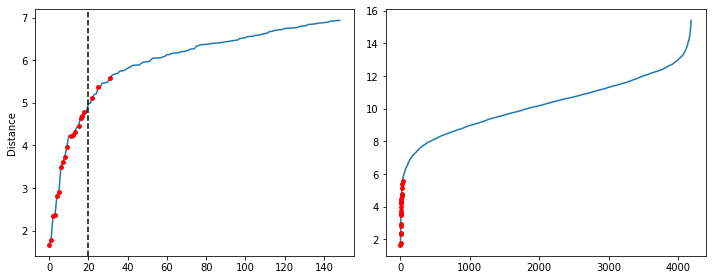

loss weights: tensor([-0.0489,  0.0035], device='cuda:0')

     TRAIN loss: 0.002368, AR accuracy: 83.99%
VALIDATION loss: 0.004090, AR accuracy: 81.47%, re-ID mAP: 63.90%
---------------------------------------------------------------------

Epoch 14:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=2.00, mean=4.55, max=6.72
Predictions distances:  min=2.00, mean=10.56, max=17.10


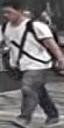

Ground truth


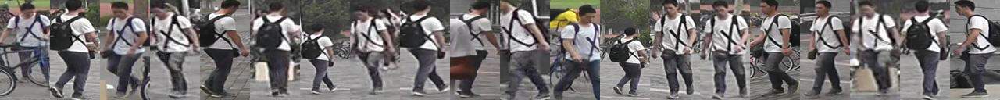

Best predictions


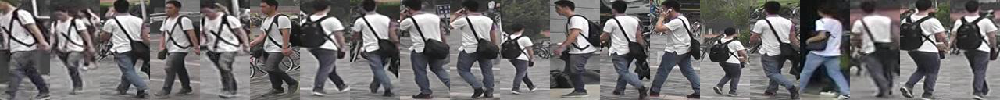

Distance values distribution for sample #2


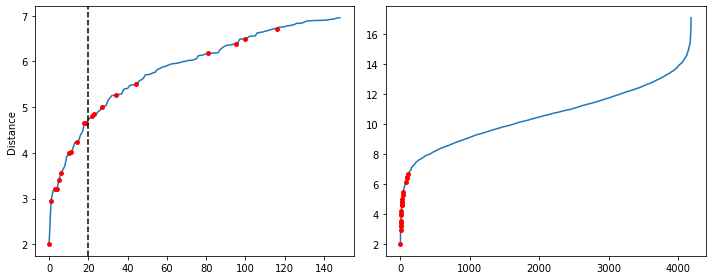

loss weights: tensor([-0.0527,  0.0002], device='cuda:0')

     TRAIN loss: 0.002354, AR accuracy: 83.77%
VALIDATION loss: 0.004027, AR accuracy: 81.87%, re-ID mAP: 63.78%
---------------------------------------------------------------------

Epoch 15:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=2.03, mean=4.04, max=6.44
Predictions distances:  min=2.03, mean=11.95, max=16.21


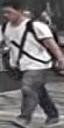

Ground truth


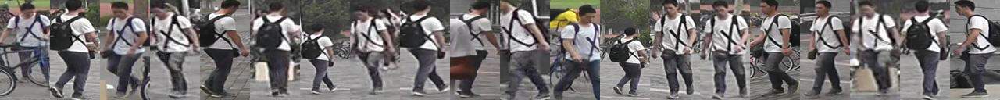

Best predictions


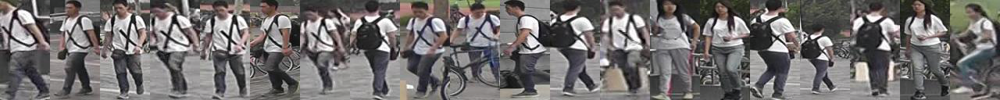

Distance values distribution for sample #2


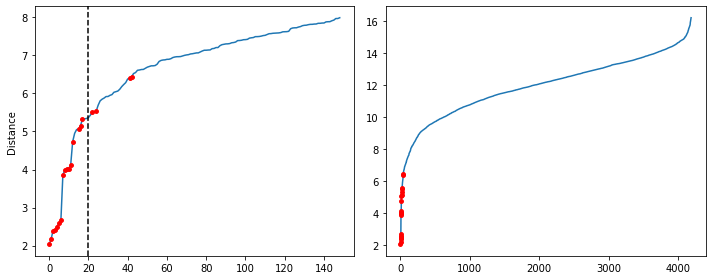

loss weights: tensor([-0.0559, -0.0031], device='cuda:0')

     TRAIN loss: 0.002364, AR accuracy: 83.90%
VALIDATION loss: 0.004323, AR accuracy: 82.63%, re-ID mAP: 64.12%
---------------------------------------------------------------------

Epoch 16:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.60, mean=3.89, max=6.59
Predictions distances:  min=1.60, mean=11.18, max=15.99


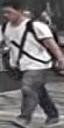

Ground truth


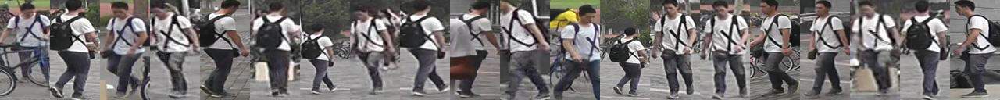

Best predictions


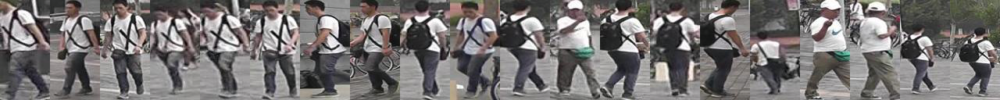

Distance values distribution for sample #2


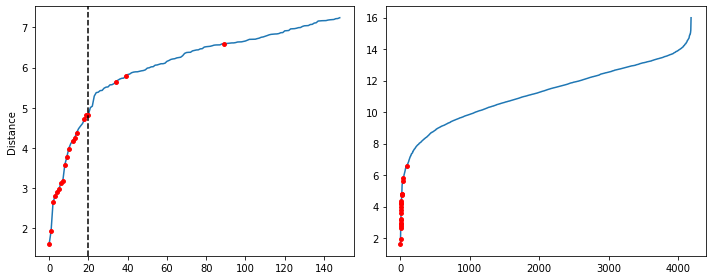

loss weights: tensor([-0.0591, -0.0068], device='cuda:0')

     TRAIN loss: 0.002305, AR accuracy: 84.62%
VALIDATION loss: 0.004181, AR accuracy: 82.54%, re-ID mAP: 64.69%
---------------------------------------------------------------------

Epoch 17:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.71, mean=3.71, max=7.10
Predictions distances:  min=1.71, mean=11.34, max=15.82


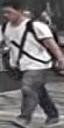

Ground truth


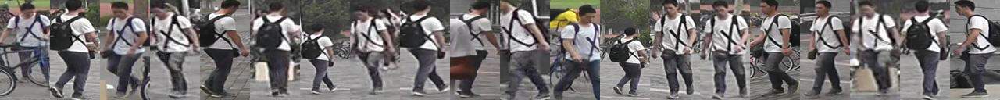

Best predictions


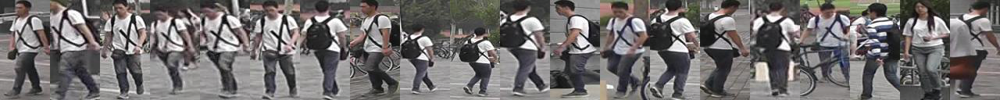

Distance values distribution for sample #2


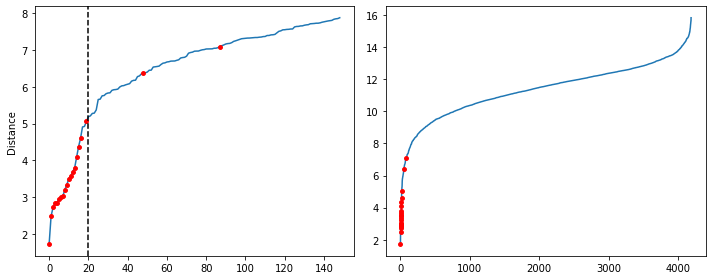

loss weights: tensor([-0.0631, -0.0106], device='cuda:0')

     TRAIN loss: 0.002248, AR accuracy: 84.70%
VALIDATION loss: 0.004165, AR accuracy: 82.69%, re-ID mAP: 65.42%
---------------------------------------------------------------------

Epoch 18:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.89, mean=3.59, max=5.07
Predictions distances:  min=1.89, mean=11.53, max=15.85


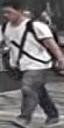

Ground truth


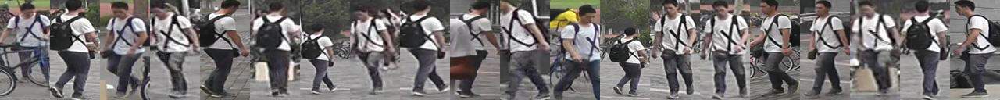

Best predictions


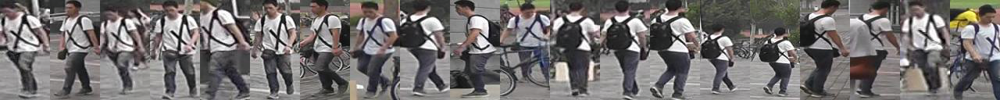

Distance values distribution for sample #2


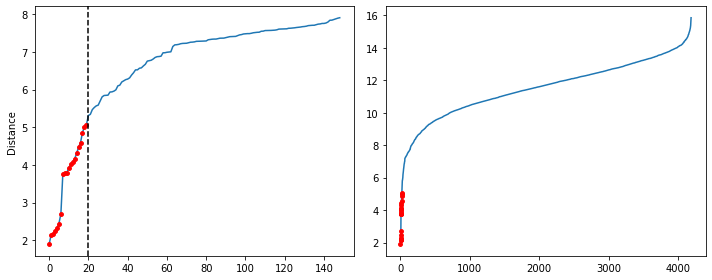

loss weights: tensor([-0.0658, -0.0144], device='cuda:0')

     TRAIN loss: 0.002263, AR accuracy: 85.02%
VALIDATION loss: 0.004249, AR accuracy: 83.05%, re-ID mAP: 64.89%
---------------------------------------------------------------------

Epoch 19:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=2.32, mean=3.75, max=7.73
Predictions distances:  min=2.32, mean=10.79, max=15.74


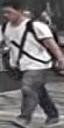

Ground truth


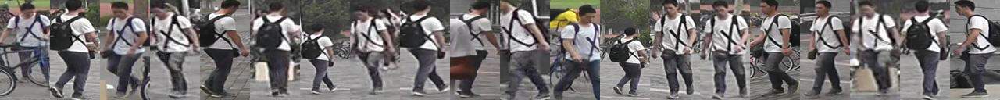

Best predictions


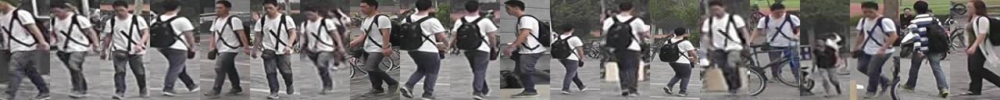

Distance values distribution for sample #2


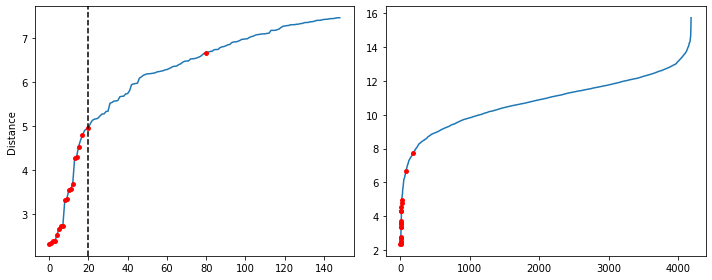

loss weights: tensor([-0.0702, -0.0185], device='cuda:0')

     TRAIN loss: 0.002147, AR accuracy: 84.80%
VALIDATION loss: 0.004105, AR accuracy: 83.03%, re-ID mAP: 64.94%
---------------------------------------------------------------------

Epoch 20:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.61, mean=3.47, max=5.93
Predictions distances:  min=1.61, mean=12.64, max=16.68


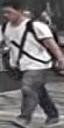

Ground truth


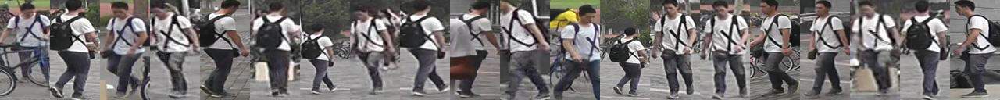

Best predictions


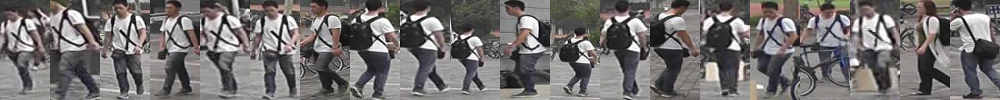

Distance values distribution for sample #2


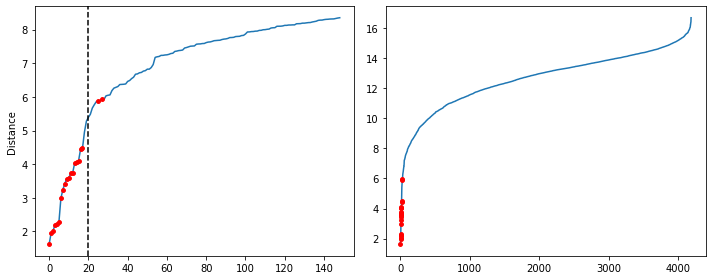

loss weights: tensor([-0.0736, -0.0226], device='cuda:0')

     TRAIN loss: 0.002242, AR accuracy: 84.87%
VALIDATION loss: 0.004271, AR accuracy: 83.35%, re-ID mAP: 65.68%
---------------------------------------------------------------------

Epoch 21:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.50, mean=3.88, max=6.55
Predictions distances:  min=1.50, mean=11.79, max=16.48


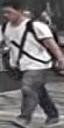

Ground truth


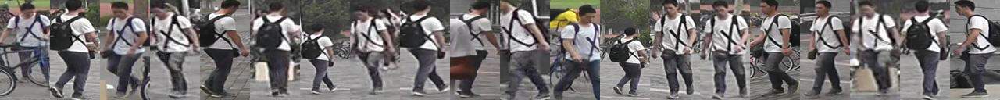

Best predictions


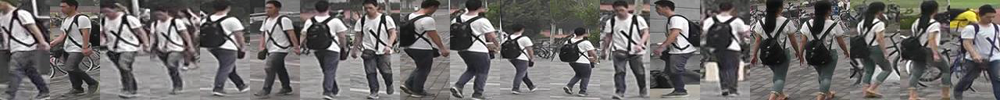

Distance values distribution for sample #2


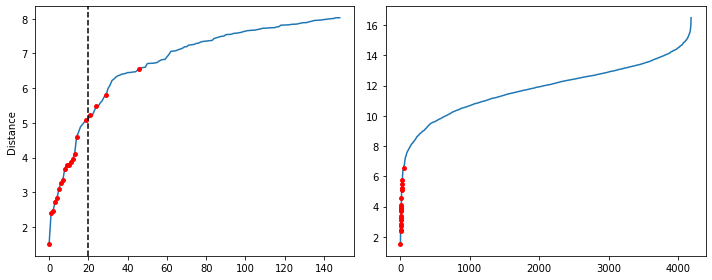

loss weights: tensor([-0.0766, -0.0265], device='cuda:0')

     TRAIN loss: 0.002161, AR accuracy: 85.65%
VALIDATION loss: 0.004204, AR accuracy: 83.06%, re-ID mAP: 66.07%
---------------------------------------------------------------------

Epoch 22:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.73, mean=4.20, max=9.35
Predictions distances:  min=1.73, mean=13.73, max=20.00


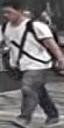

Ground truth


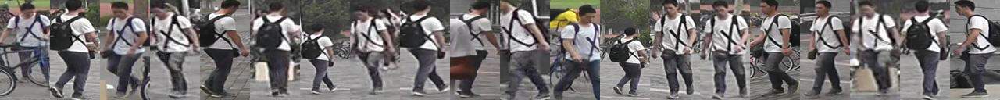

Best predictions


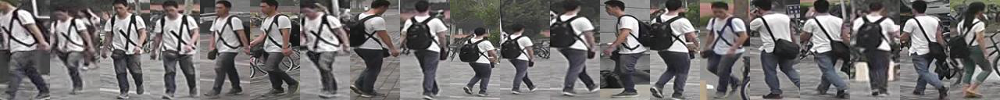

Distance values distribution for sample #2


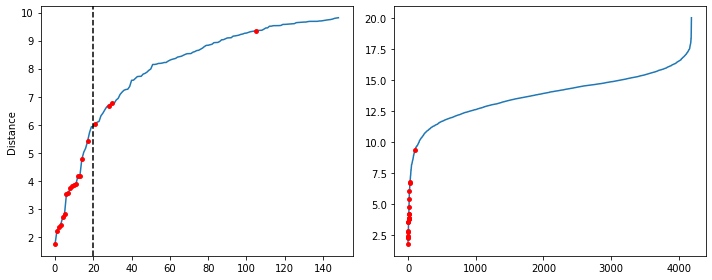

loss weights: tensor([-0.0792, -0.0304], device='cuda:0')

     TRAIN loss: 0.002290, AR accuracy: 85.16%
VALIDATION loss: 0.004417, AR accuracy: 82.23%, re-ID mAP: 61.33%
---------------------------------------------------------------------

Epoch 23:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.87, mean=3.61, max=6.47
Predictions distances:  min=1.87, mean=12.24, max=17.07


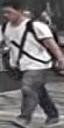

Ground truth


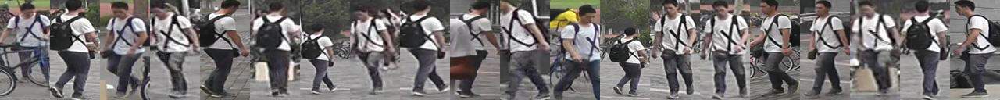

Best predictions


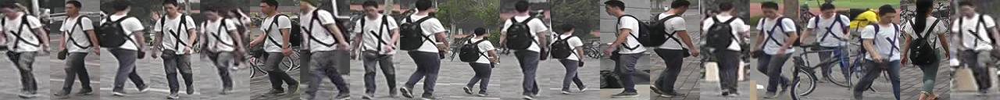

Distance values distribution for sample #2


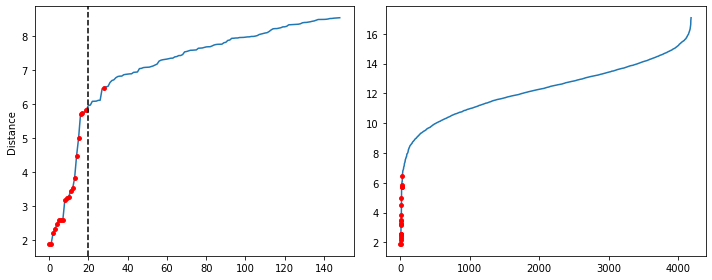

loss weights: tensor([-0.0807, -0.0345], device='cuda:0')

     TRAIN loss: 0.002278, AR accuracy: 85.22%
VALIDATION loss: 0.004529, AR accuracy: 82.68%, re-ID mAP: 64.53%
---------------------------------------------------------------------

Epoch 24:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.76, mean=3.43, max=5.79
Predictions distances:  min=1.76, mean=11.53, max=16.65


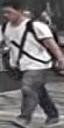

Ground truth


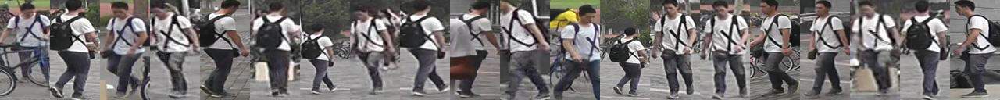

Best predictions


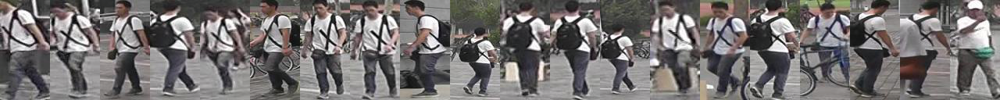

Distance values distribution for sample #2


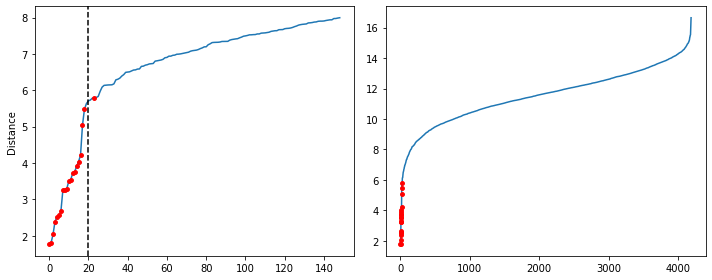

loss weights: tensor([-0.0822, -0.0382], device='cuda:0')

     TRAIN loss: 0.002225, AR accuracy: 85.41%
VALIDATION loss: 0.004577, AR accuracy: 81.88%, re-ID mAP: 65.72%
---------------------------------------------------------------------

Epoch 25:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.49, mean=4.34, max=7.84
Predictions distances:  min=1.49, mean=11.49, max=16.46


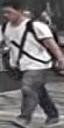

Ground truth


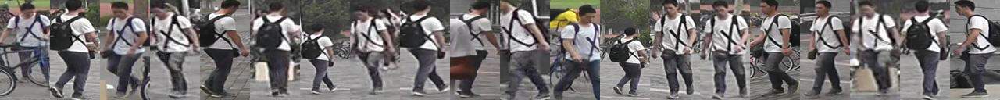

Best predictions


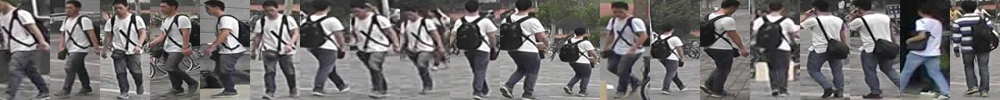

Distance values distribution for sample #2


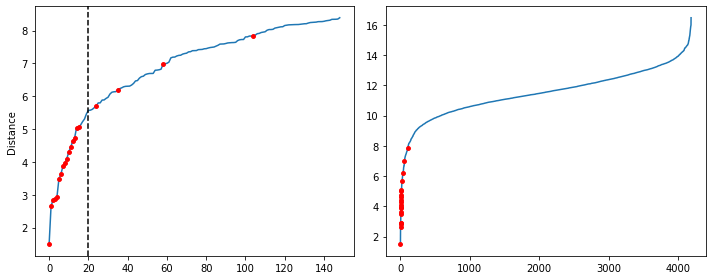

loss weights: tensor([-0.0841, -0.0425], device='cuda:0')

     TRAIN loss: 0.002191, AR accuracy: 85.33%
VALIDATION loss: 0.004376, AR accuracy: 82.91%, re-ID mAP: 64.61%
---------------------------------------------------------------------

Epoch 26:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.59, mean=3.37, max=6.15
Predictions distances:  min=1.59, mean=12.45, max=16.73


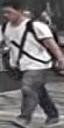

Ground truth


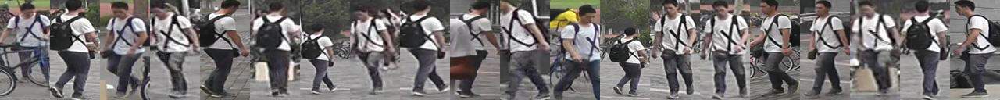

Best predictions


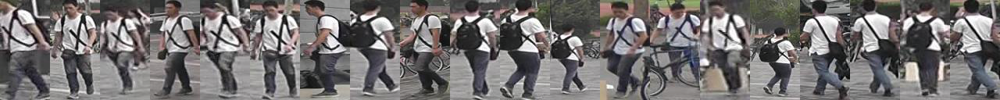

Distance values distribution for sample #2


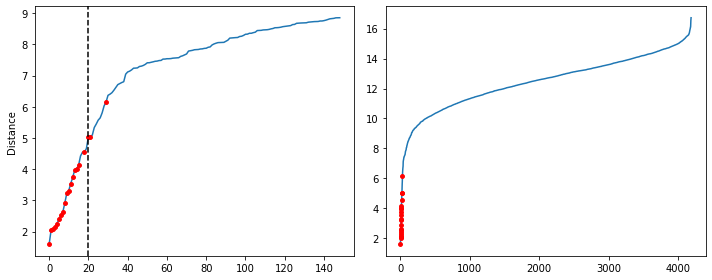

loss weights: tensor([-0.0866, -0.0464], device='cuda:0')

     TRAIN loss: 0.002119, AR accuracy: 85.99%
VALIDATION loss: 0.004231, AR accuracy: 83.03%, re-ID mAP: 64.54%
---------------------------------------------------------------------

Epoch 27:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.95, mean=3.84, max=7.08
Predictions distances:  min=1.95, mean=11.83, max=17.08


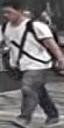

Ground truth


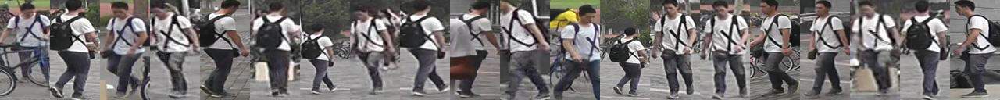

Best predictions


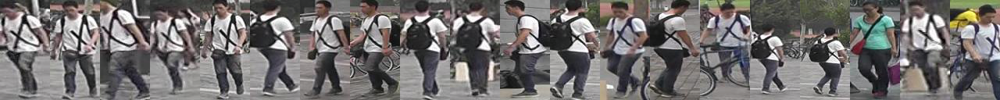

Distance values distribution for sample #2


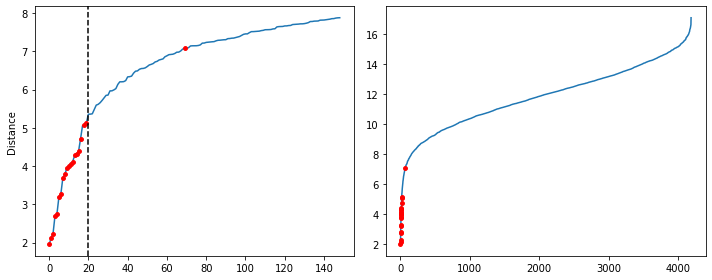

loss weights: tensor([-0.0892, -0.0506], device='cuda:0')

     TRAIN loss: 0.002128, AR accuracy: 85.55%
VALIDATION loss: 0.004296, AR accuracy: 83.01%, re-ID mAP: 66.44%
---------------------------------------------------------------------

Epoch 28:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.65, mean=3.93, max=7.00
Predictions distances:  min=1.65, mean=13.07, max=17.83


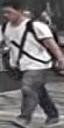

Ground truth


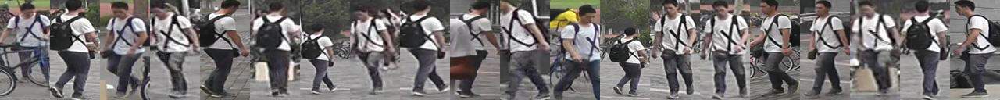

Best predictions


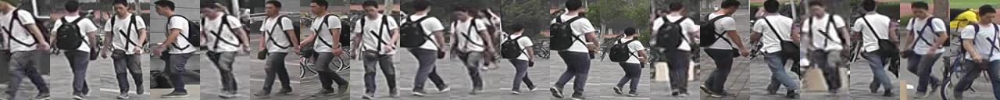

Distance values distribution for sample #2


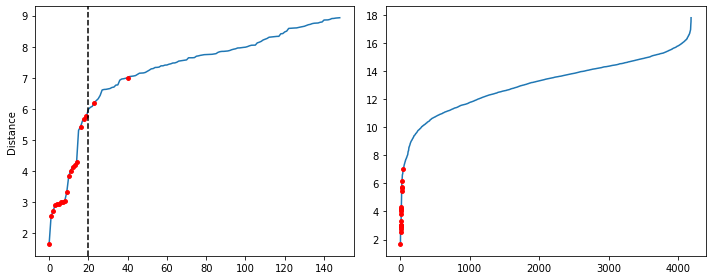

loss weights: tensor([-0.0912, -0.0545], device='cuda:0')

     TRAIN loss: 0.002153, AR accuracy: 85.88%
VALIDATION loss: 0.004226, AR accuracy: 83.24%, re-ID mAP: 65.97%
---------------------------------------------------------------------

Epoch 29:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.48, mean=4.32, max=7.75
Predictions distances:  min=1.48, mean=12.94, max=17.82


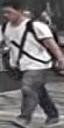

Ground truth


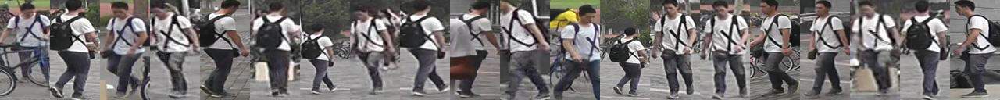

Best predictions


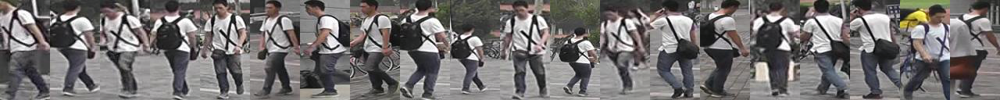

Distance values distribution for sample #2


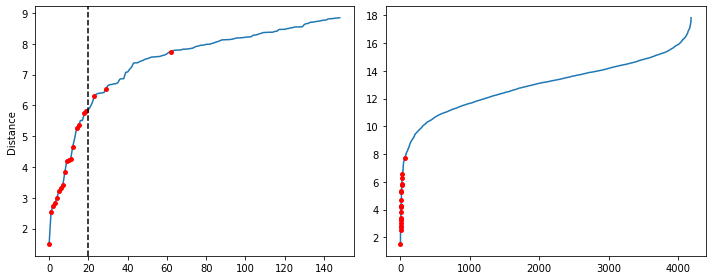

loss weights: tensor([-0.0934, -0.0587], device='cuda:0')

     TRAIN loss: 0.002109, AR accuracy: 85.70%
VALIDATION loss: 0.004578, AR accuracy: 83.14%, re-ID mAP: 66.47%
---------------------------------------------------------------------

Epoch 30:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.80, mean=4.15, max=7.53
Predictions distances:  min=1.80, mean=11.65, max=17.35


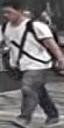

Ground truth


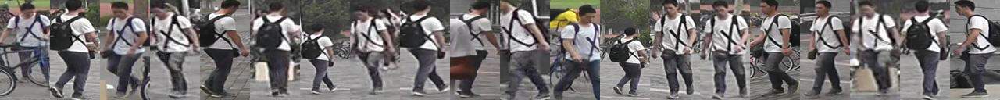

Best predictions


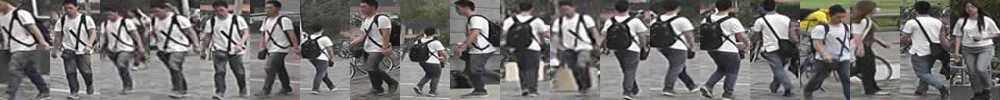

Distance values distribution for sample #2


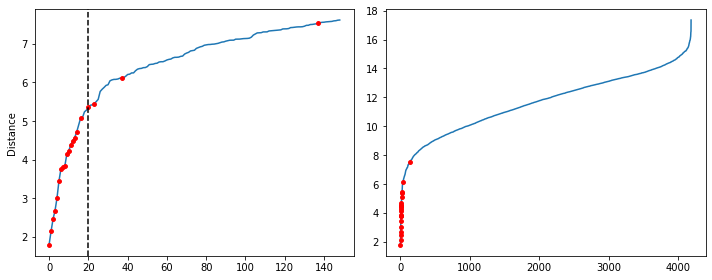

loss weights: tensor([-0.0943, -0.0624], device='cuda:0')

     TRAIN loss: 0.002229, AR accuracy: 86.15%
VALIDATION loss: 0.004525, AR accuracy: 83.21%, re-ID mAP: 63.03%
---------------------------------------------------------------------

Epoch 31:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=2.56, mean=4.64, max=8.79
Predictions distances:  min=2.56, mean=12.47, max=17.97


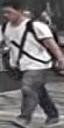

Ground truth


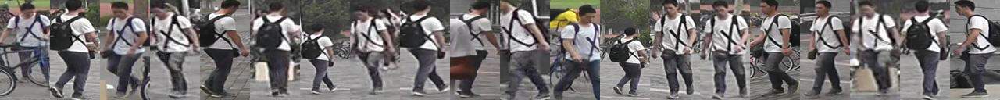

Best predictions


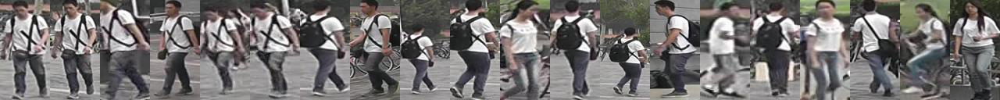

Distance values distribution for sample #2


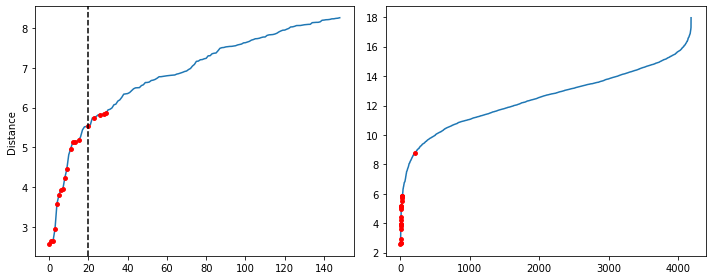

loss weights: tensor([-0.0954, -0.0662], device='cuda:0')

     TRAIN loss: 0.002194, AR accuracy: 85.75%
VALIDATION loss: 0.004297, AR accuracy: 83.28%, re-ID mAP: 64.10%
---------------------------------------------------------------------

Epoch 32:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.54, mean=4.05, max=6.87
Predictions distances:  min=1.54, mean=12.84, max=18.07


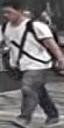

Ground truth


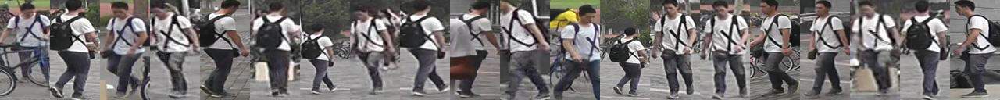

Best predictions


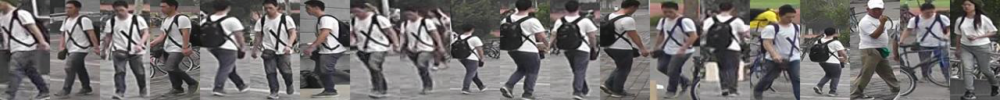

Distance values distribution for sample #2


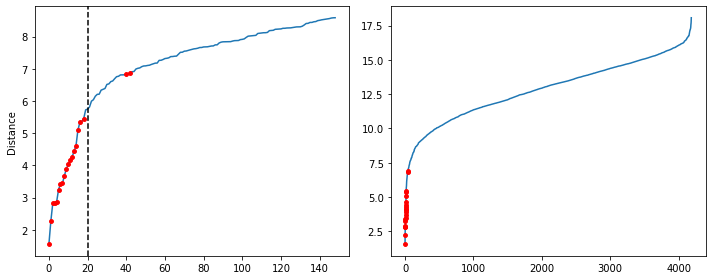

loss weights: tensor([-0.0965, -0.0700], device='cuda:0')

     TRAIN loss: 0.002119, AR accuracy: 86.12%
VALIDATION loss: 0.004355, AR accuracy: 83.23%, re-ID mAP: 67.08%
---------------------------------------------------------------------

Epoch 33:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.56, mean=3.98, max=6.39
Predictions distances:  min=1.56, mean=12.69, max=17.94


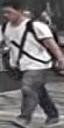

Ground truth


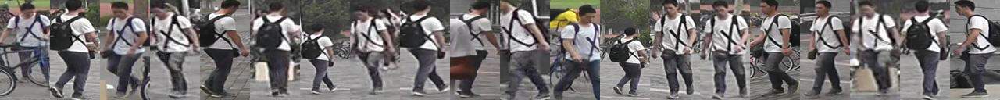

Best predictions


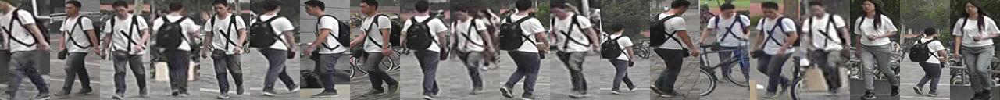

Distance values distribution for sample #2


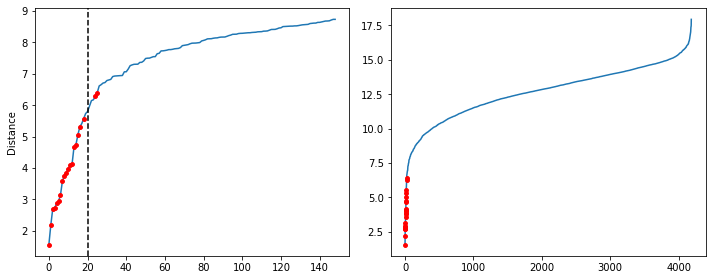

loss weights: tensor([-0.0975, -0.0738], device='cuda:0')

     TRAIN loss: 0.002142, AR accuracy: 86.51%
VALIDATION loss: 0.004705, AR accuracy: 83.01%, re-ID mAP: 66.63%
---------------------------------------------------------------------

Epoch 34:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.38, mean=4.57, max=8.71
Predictions distances:  min=1.38, mean=13.01, max=17.86


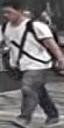

Ground truth


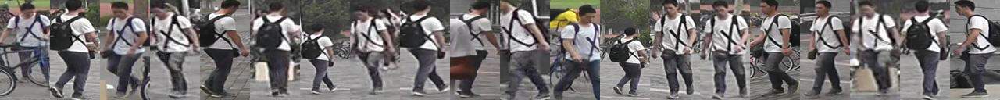

Best predictions


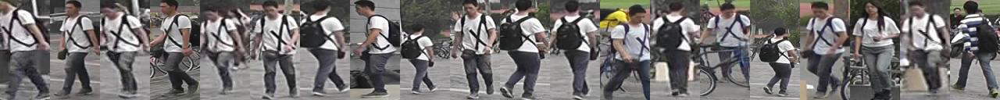

Distance values distribution for sample #2


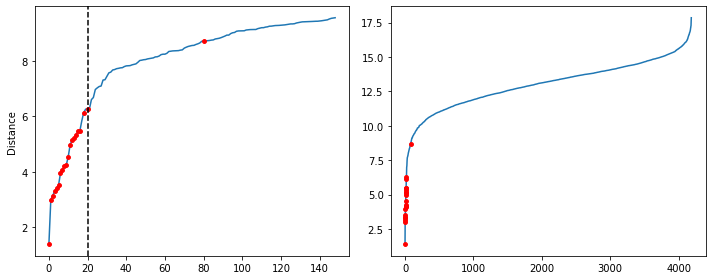

loss weights: tensor([-0.0984, -0.0779], device='cuda:0')

     TRAIN loss: 0.002065, AR accuracy: 86.19%
VALIDATION loss: 0.004362, AR accuracy: 83.54%, re-ID mAP: 67.17%
---------------------------------------------------------------------

Epoch 35:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.26, mean=3.81, max=6.81
Predictions distances:  min=1.26, mean=12.71, max=18.83


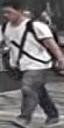

Ground truth


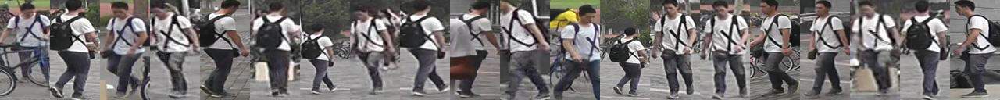

Best predictions


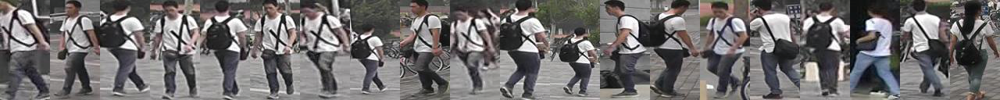

Distance values distribution for sample #2


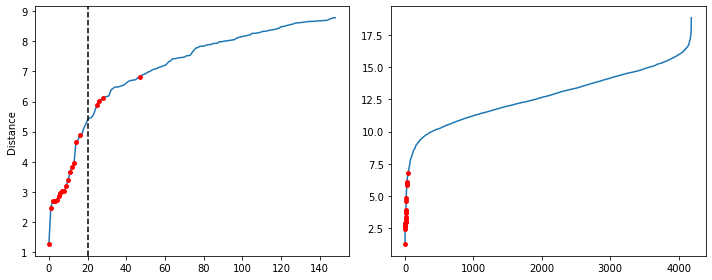

loss weights: tensor([-0.0992, -0.0818], device='cuda:0')

     TRAIN loss: 0.002180, AR accuracy: 86.26%
VALIDATION loss: 0.004394, AR accuracy: 83.35%, re-ID mAP: 64.68%
---------------------------------------------------------------------

Epoch 36:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.63, mean=3.23, max=7.70
Predictions distances:  min=1.63, mean=13.45, max=18.63


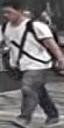

Ground truth


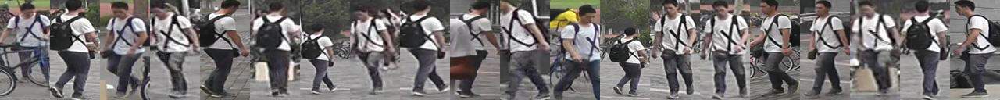

Best predictions


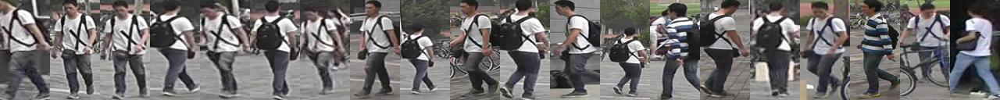

Distance values distribution for sample #2


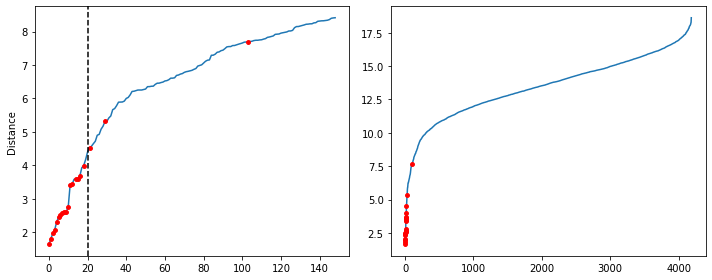

loss weights: tensor([-0.1003, -0.0854], device='cuda:0')

     TRAIN loss: 0.002091, AR accuracy: 86.48%
VALIDATION loss: 0.004369, AR accuracy: 83.13%, re-ID mAP: 67.95%
---------------------------------------------------------------------

Epoch 37:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.19, mean=3.56, max=6.72
Predictions distances:  min=1.19, mean=13.58, max=19.94


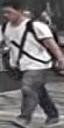

Ground truth


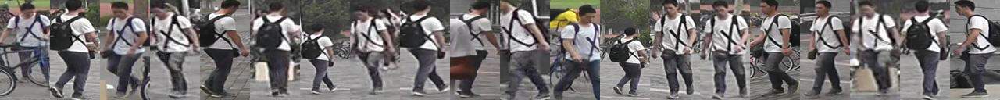

Best predictions


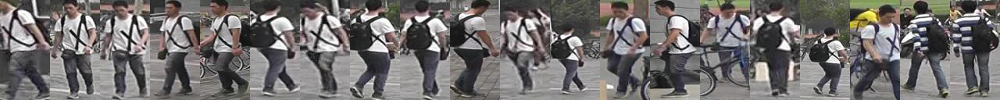

Distance values distribution for sample #2


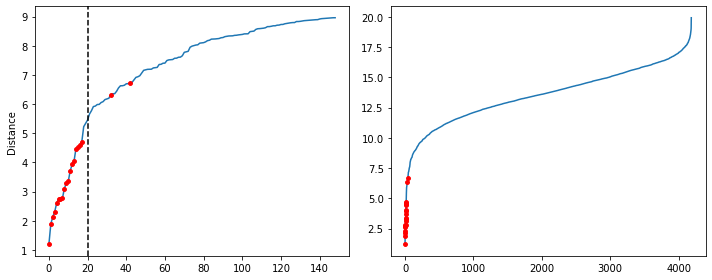

loss weights: tensor([-0.1015, -0.0892], device='cuda:0')

     TRAIN loss: 0.002083, AR accuracy: 86.33%
VALIDATION loss: 0.004636, AR accuracy: 83.41%, re-ID mAP: 67.02%
---------------------------------------------------------------------

Epoch 38:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.16, mean=4.20, max=7.61
Predictions distances:  min=1.16, mean=12.15, max=17.87


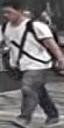

Ground truth


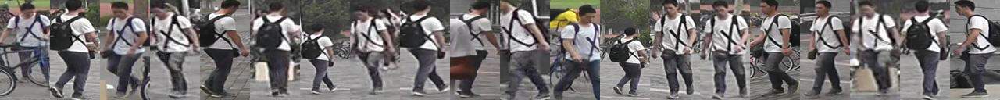

Best predictions


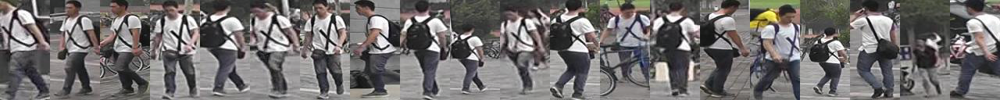

Distance values distribution for sample #2


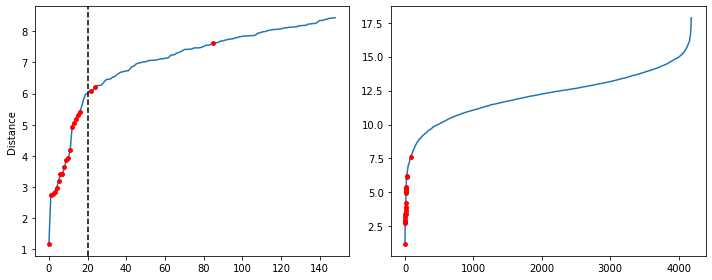

loss weights: tensor([-0.1026, -0.0931], device='cuda:0')

     TRAIN loss: 0.002055, AR accuracy: 86.42%
VALIDATION loss: 0.004306, AR accuracy: 83.60%, re-ID mAP: 67.19%
---------------------------------------------------------------------

Epoch 39:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.35, mean=3.77, max=8.28
Predictions distances:  min=1.35, mean=12.51, max=18.94


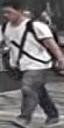

Ground truth


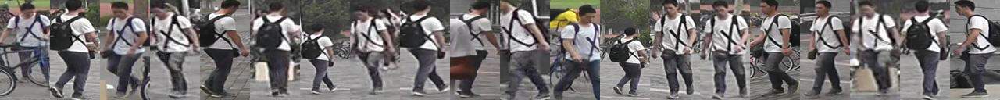

Best predictions


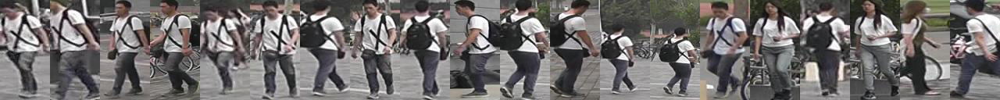

Distance values distribution for sample #2


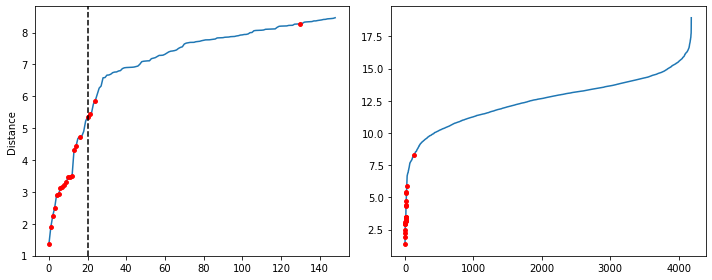

loss weights: tensor([-0.1035, -0.0965], device='cuda:0')

     TRAIN loss: 0.002094, AR accuracy: 86.23%
VALIDATION loss: 0.004531, AR accuracy: 82.96%, re-ID mAP: 66.74%
---------------------------------------------------------------------

Epoch 40:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.47, mean=3.62, max=6.85
Predictions distances:  min=1.47, mean=11.92, max=18.03


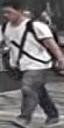

Ground truth


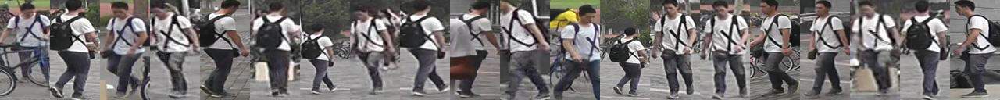

Best predictions


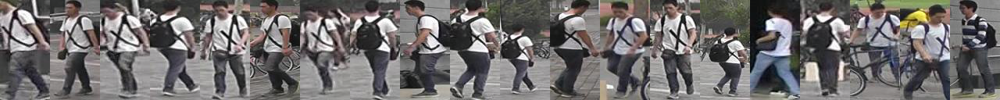

Distance values distribution for sample #2


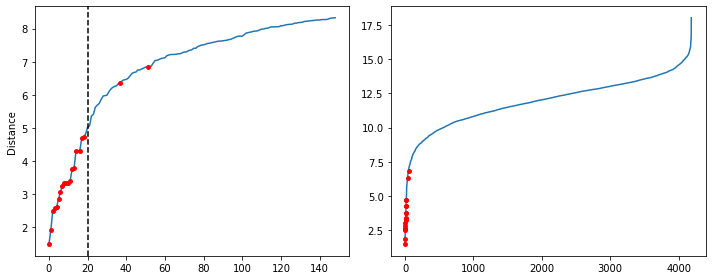

loss weights: tensor([-0.1038, -0.1004], device='cuda:0')

     TRAIN loss: 0.002134, AR accuracy: 86.52%
VALIDATION loss: 0.004474, AR accuracy: 82.86%, re-ID mAP: 64.98%
---------------------------------------------------------------------

Epoch 41:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.90, mean=4.29, max=7.76
Predictions distances:  min=1.90, mean=12.55, max=17.65


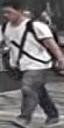

Ground truth


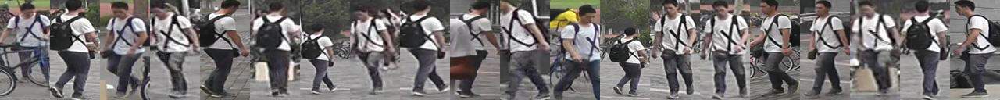

Best predictions


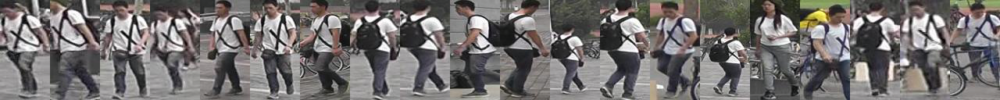

Distance values distribution for sample #2


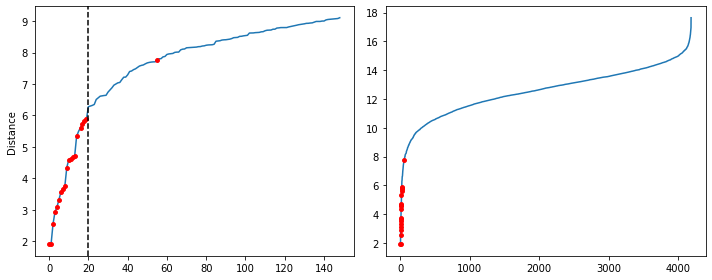

loss weights: tensor([-0.1049, -0.1037], device='cuda:0')

     TRAIN loss: 0.002022, AR accuracy: 86.44%
VALIDATION loss: 0.004530, AR accuracy: 82.91%, re-ID mAP: 66.12%
---------------------------------------------------------------------

Epoch 42:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.42, mean=4.48, max=8.74
Predictions distances:  min=1.42, mean=14.41, max=19.84


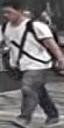

Ground truth


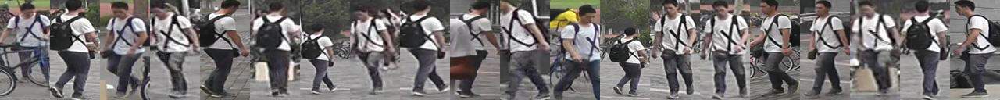

Best predictions


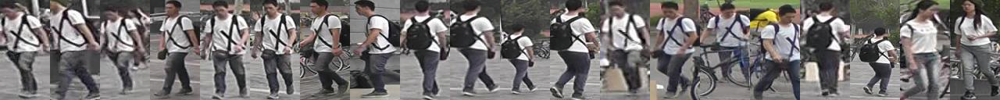

Distance values distribution for sample #2


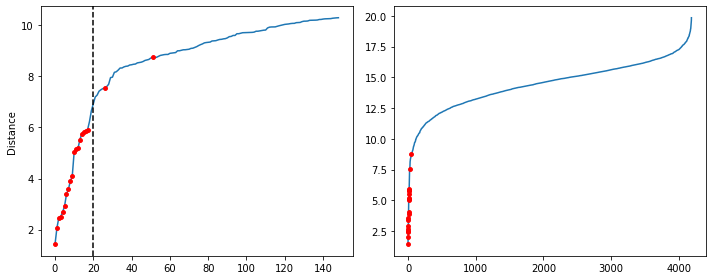

loss weights: tensor([-0.1057, -0.1070], device='cuda:0')

     TRAIN loss: 0.002104, AR accuracy: 85.92%
VALIDATION loss: 0.004442, AR accuracy: 83.69%, re-ID mAP: 67.61%
---------------------------------------------------------------------

Epoch 43:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.76, mean=3.94, max=7.60
Predictions distances:  min=1.76, mean=14.17, max=20.00


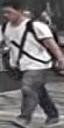

Ground truth


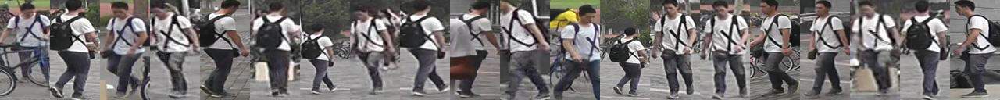

Best predictions


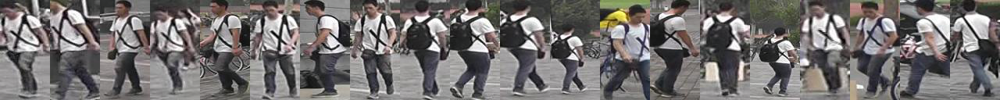

Distance values distribution for sample #2


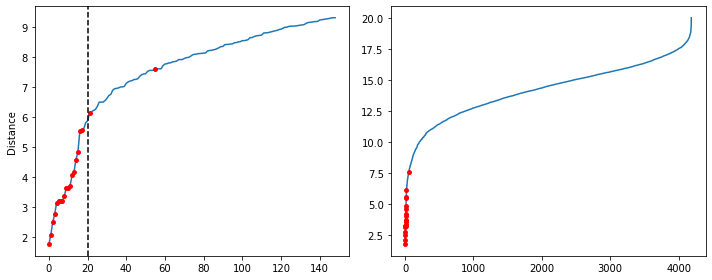

loss weights: tensor([-0.1065, -0.1097], device='cuda:0')

     TRAIN loss: 0.002057, AR accuracy: 86.73%
VALIDATION loss: 0.004613, AR accuracy: 83.65%, re-ID mAP: 67.95%
---------------------------------------------------------------------

Epoch 44:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.59, mean=4.28, max=7.32
Predictions distances:  min=1.59, mean=14.07, max=21.57


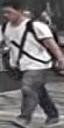

Ground truth


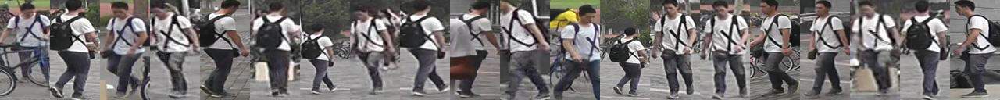

Best predictions


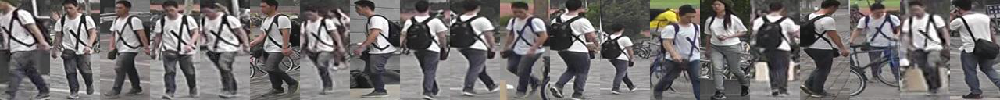

Distance values distribution for sample #2


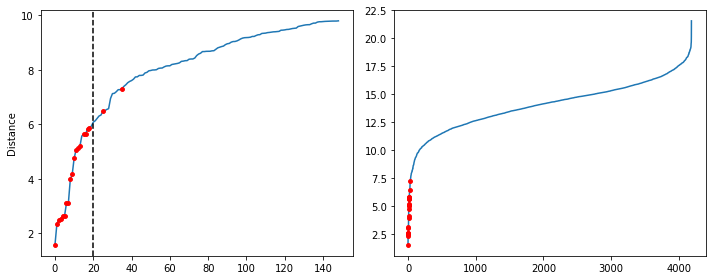

loss weights: tensor([-0.1080, -0.1132], device='cuda:0')

     TRAIN loss: 0.001992, AR accuracy: 86.56%
VALIDATION loss: 0.004494, AR accuracy: 83.51%, re-ID mAP: 67.89%
---------------------------------------------------------------------

Epoch 45:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=2.17, mean=4.17, max=7.35
Predictions distances:  min=2.17, mean=12.42, max=17.94


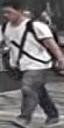

Ground truth


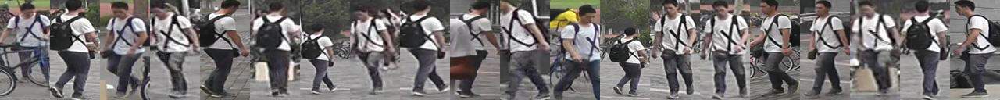

Best predictions


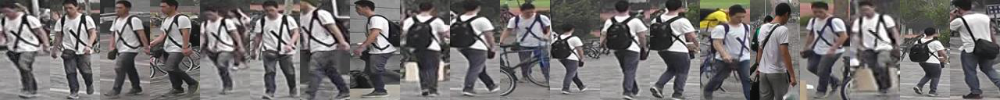

Distance values distribution for sample #2


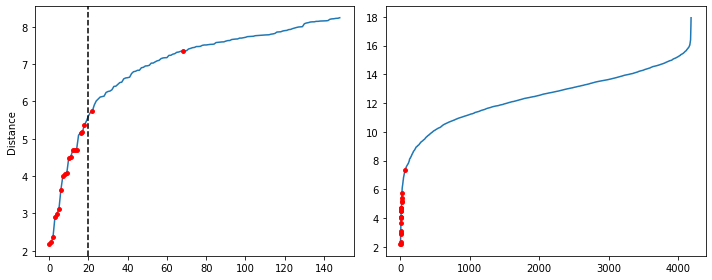

loss weights: tensor([-0.1100, -0.1166], device='cuda:0')

     TRAIN loss: 0.001995, AR accuracy: 86.93%
VALIDATION loss: 0.004567, AR accuracy: 82.57%, re-ID mAP: 65.22%
---------------------------------------------------------------------

Epoch 46:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.49, mean=3.60, max=6.01
Predictions distances:  min=1.49, mean=12.31, max=18.42


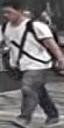

Ground truth


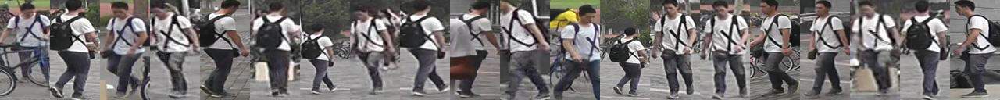

Best predictions


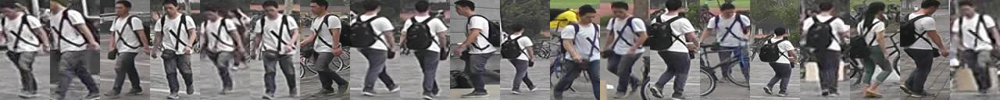

Distance values distribution for sample #2


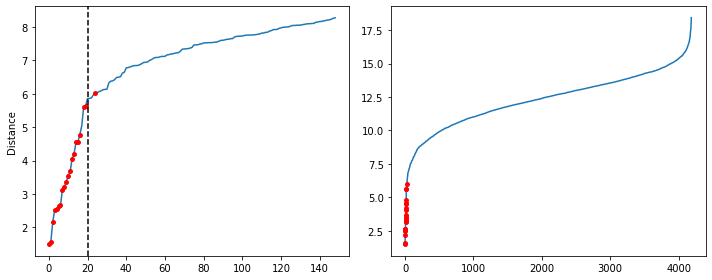

loss weights: tensor([-0.1114, -0.1199], device='cuda:0')

     TRAIN loss: 0.001943, AR accuracy: 86.83%
VALIDATION loss: 0.004517, AR accuracy: 83.34%, re-ID mAP: 67.49%
---------------------------------------------------------------------

Epoch 47:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=2.09, mean=4.12, max=6.95
Predictions distances:  min=2.09, mean=11.91, max=17.22


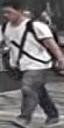

Ground truth


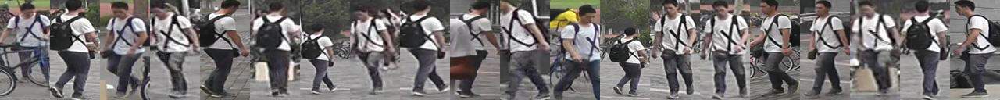

Best predictions


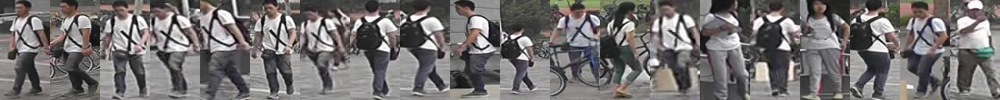

Distance values distribution for sample #2


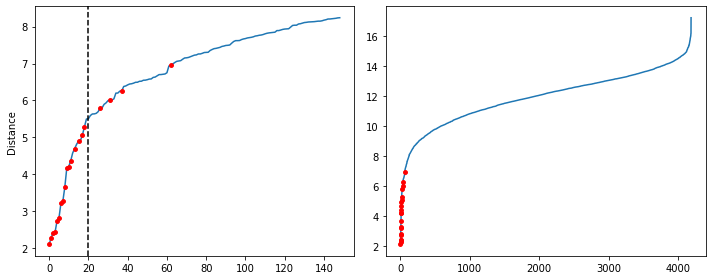

loss weights: tensor([-0.1127, -0.1232], device='cuda:0')

     TRAIN loss: 0.002043, AR accuracy: 86.82%
VALIDATION loss: 0.004347, AR accuracy: 83.83%, re-ID mAP: 66.84%
---------------------------------------------------------------------

Epoch 48:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.79, mean=4.23, max=8.39
Predictions distances:  min=1.79, mean=13.67, max=18.89


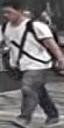

Ground truth


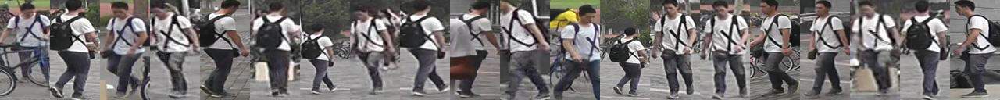

Best predictions


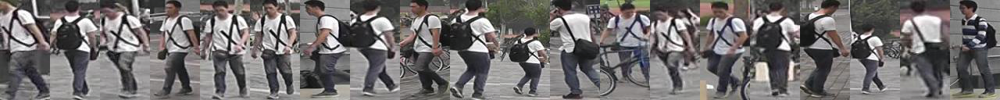

Distance values distribution for sample #2


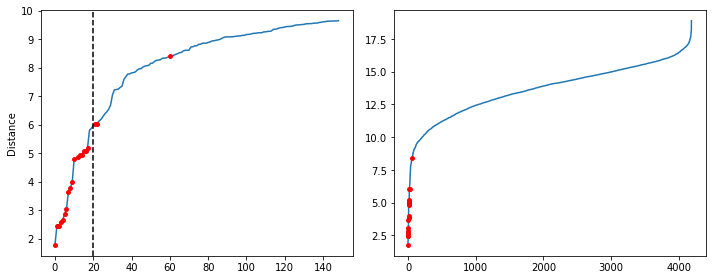

loss weights: tensor([-0.1135, -0.1263], device='cuda:0')

     TRAIN loss: 0.002030, AR accuracy: 87.08%
VALIDATION loss: 0.004695, AR accuracy: 83.18%, re-ID mAP: 68.06%
---------------------------------------------------------------------

Epoch 49:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.31, mean=3.53, max=5.50
Predictions distances:  min=1.31, mean=14.31, max=19.63


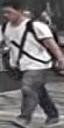

Ground truth


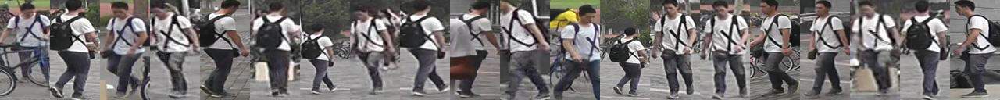

Best predictions


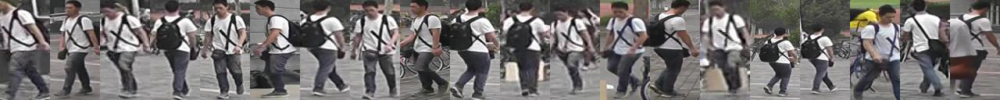

Distance values distribution for sample #2


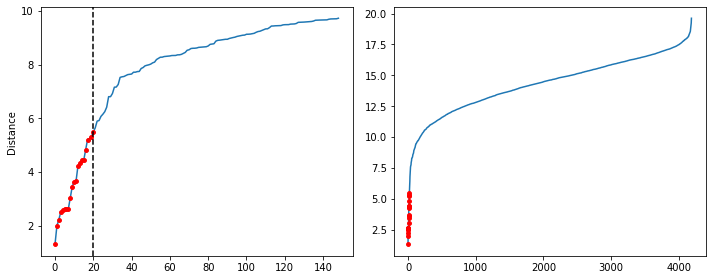

loss weights: tensor([-0.1148, -0.1295], device='cuda:0')

     TRAIN loss: 0.001900, AR accuracy: 86.99%
VALIDATION loss: 0.004605, AR accuracy: 84.11%, re-ID mAP: 68.37%
---------------------------------------------------------------------

Epoch 50:


Training:   0%|          | 0/15 [00:00<?, ?it/s]

Testing:   0%|          | 0/17 [00:00<?, ?it/s]


Sample #2 (ID: 303)
Ground truth distances: min=1.57, mean=4.18, max=7.65
Predictions distances:  min=1.57, mean=12.58, max=18.02


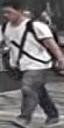

Ground truth


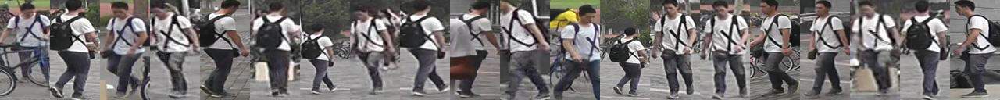

Best predictions


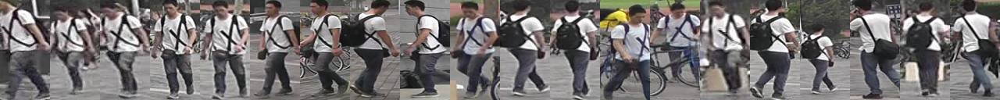

Distance values distribution for sample #2


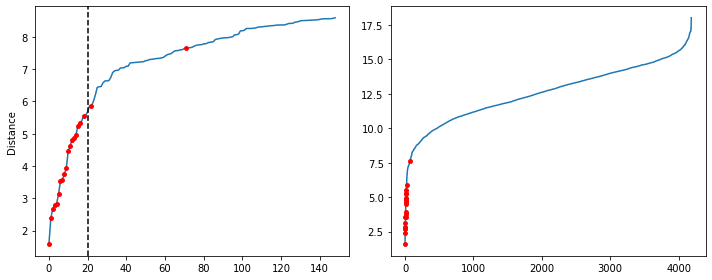

loss weights: tensor([-0.1158, -0.1327], device='cuda:0')

     TRAIN loss: 0.002007, AR accuracy: 87.34%
VALIDATION loss: 0.004445, AR accuracy: 83.22%, re-ID mAP: 67.60%
---------------------------------------------------------------------

Validation accuracy by label:
age          78.56%
backpack     81.49%
bag          73.71%
handbag      90.38%
clothes      88.68%
down         87.73%
up           93.91%
hair          86.1%
hat          96.35%
gender       87.44%
upcolor      69.94%
downcolor    64.35%
avg          83.22%
dtype: object


In [21]:
logging.getLogger('wandb').setLevel(logging.ERROR) # Disable wandb info logs
set_seed(42)
os.environ['CUDA_LAUNCH_BLOCKING'] = '0' # Set to 1 to debug, 0 otherwise
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f'Running on device "{device}"\n')

# Run experiments
model = main(
  'trinet', 
  epochs=50, 
  P=34, 
  K=10,
  model_params=dict(
    backbone='resNet',  # selfAttention convHead resNet
    hidden_size=512,
    freeze_loss_weights=False,
    attribute_branch_out_conv_features=16, 
    reid_dim_embedding=128
  ),
  optimizer_params=dict(
    lr=0.0003,
    weight_decay=0.003
  ),
  loss_params=dict(
    margin=1,
  ),
  device=device,
  disable_wandb=True
)

# Final predictions
Make predictions on the test and query sets

In [47]:
def get_test_query_data(batch_size):
  # Load data
  test_data = Market1501Dataset(split='test', transform=normalization_transform, target_transform=torch.tensor)
  query_data = Market1501Dataset(split='queries', transform=normalization_transform, target_transform=torch.tensor)
  print(f'Datasets:')
  print(f' - Test:    {len(test_data)}')
  print(f' - Queries: {len(query_data)}\n')
  # Initialize dataloaders
  test_loader = torch.utils.data.DataLoader(test_data, batch_size, pin_memory=True, worker_init_fn=seed_worker, num_workers=2)
  query_loader = torch.utils.data.DataLoader(query_data, batch_size, pin_memory=True, worker_init_fn=seed_worker, num_workers=2)
  return test_loader, query_loader

def predict(model, desc, data_loader):
  out_shapes=[4,1,1,1,1,1,1,1,1,1,9,10]
  computed_embeddings = torch.zeros(len(data_loader.dataset), model.reid_dim_embedding, device=device, dtype=torch.float)
  attributes = [torch.zeros(len(data_loader.dataset), s, device=device, dtype=torch.float) for s in out_shapes]
  for batch_idx, (inputs, _, idx, _) in enumerate(tqdm(data_loader, desc=desc)):
    inputs, idx = inputs.to(device, non_blocking=True), idx.to(device, non_blocking=True) 
    embeddings, attr = model(inputs)
    computed_embeddings[idx] = embeddings
    for attribute, prediction in zip(attributes, attr):
      attribute[idx] = prediction
  return computed_embeddings, attributes

def write_reid_output(test_embeddings, query_embeddings, test_filenames, query_filenames, n_predictions, output_file='reid_test.txt'):
  '''
  For each query image with filename q_i, produce a list of images
  in the test folder with filenames t_{i,1}, t_{i,2}, ..., t_{i,m_i}
  that the model believes depict the same person as qi.
  Produce a file containing your predictions named reid_test.txt with
  2.248 rows, one for each query image. The ith row has the format 
  
  q_i : t_{i,1}, t_{i,2}, ..., t_{i,m_i}
  '''
  # Compute pairwise distances and re-ID predictions
  dist = torch.cdist(query_embeddings.unsqueeze(0), test_embeddings.unsqueeze(0), p=2).squeeze(0)
  predictions = dist.sort(dim=1).indices
  with open(output_file, 'w') as f:
    for idx, pred in enumerate(predictions[:, :n_predictions].cpu()):
      pred_names = test_filenames.iloc[pred]
      pred_s = ', '.join(pred_names)
      f.write(f'{query_filenames.iloc[idx]}: {pred_s}\n')


def check_reid_output(output_file, n_queries=10, n_predictions=10):
  '''
  Visualize some outputs for the ReID task
  '''
  QUERY_PATH = f'{DATASET_BASE_PATH}/queries' 
  TEST_PATH = f'{DATASET_BASE_PATH}/test' 
  with open(output_file, 'r') as f:
    lines = f.readlines()
    assert len(lines) == 2248
    for r in np.random.choice(lines, n_queries, replace=False):
      q, pred = r.split(':')
      display(Image.open(f'{QUERY_PATH}/{q.strip()}'))
      pred_img = torch.cat([T.ToTensor()(Image.open(f'{TEST_PATH}/{q.strip()}')) for q in pred.split(',')[:n_predictions]], dim=2)
      display(T.ToPILImage()(pred_img).convert("RGB"))
  

def write_ar_output(test_attr, test_filenames, output_file):
  data = pd.DataFrame()
  data['id']           = test_filenames
  data['age']          = 1 + test_attr[0].argmax(1).cpu().numpy()
  # binary outputs
  data['backpack']     = 1 + (test_attr[1] > 0).cpu().numpy()
  data['bag']          = 1 + (test_attr[2] > 0).cpu().numpy()
  data['handbag']      = 1 + (test_attr[3] > 0).cpu().numpy()
  data['clothes']      = 1 + (test_attr[4] > 0).cpu().numpy()
  data['down']         = 1 + (test_attr[5] > 0).cpu().numpy()
  data['up']           = 1 + (test_attr[6] > 0).cpu().numpy()
  data['hair']         = 1 + (test_attr[7] > 0).cpu().numpy()
  data['hat']          = 1 + (test_attr[8] > 0).cpu().numpy()
  data['gender']       = 1 + (test_attr[9] > 0).cpu().numpy()

  # output colors with a one-hot encoding (ignore multicolor predictions)
  up_cols =   ['upblack', 'upwhite', 'upred', 'uppurple', 'upyellow', 'upgray', 'upblue', 'upgreen']
  down_cols = ['downblack', 'downwhite', 'downpink', 'downpurple', 'downyellow', 'downgray', 'downblue', 'downgreen', 'downbrown']
  for i, col_name in enumerate(up_cols):
    data[col_name] = 1 + (test_attr[10].argmax(1)==i).cpu().numpy()

  for i, col_name in enumerate(down_cols):
    data[col_name] = 1 + (test_attr[11].argmax(1)==i).cpu().numpy()
  data.to_csv(output_file, index=False)


def check_ar_output(output_file, n_img=10):
  '''
  Visualize some outputs for the AR task
  '''
  TEST_PATH = f'{DATASET_BASE_PATH}/test'
  data = pd.read_csv(output_file, index_col=False)
  ann = pd.read_csv(f'{DATASET_BASE_PATH}/annotations_train.csv')
  
  assert data.columns.equals(ann.columns)
  assert len(data) == 19679

  for _, r in data.sample(n=n_img, replace=False).iterrows():
    display(Image.open(f'{TEST_PATH}/{r.id}'))
    print("Attributes predicted")
    for col, value in r[r.index != 'id'].items():
      print(f'{col:11s} : {value:2d}')

def write_output(model, ar_params, reid_params):
  test_loader, query_loader = get_test_query_data(batch_size=512)
  # AR task
  # Compute embeddings and attributes predictions for test images
  with torch.set_grad_enabled(False):
    test_embeddings, test_attr = predict(model, 'Test', test_loader)
  test_filenames = test_loader.dataset.filenames
  write_ar_output(test_attr, test_filenames, **ar_params)
  # ReID task
  # Compute embeddings for query images
  with torch.set_grad_enabled(False):  
    query_embeddings, _ = predict(model, 'Query', query_loader)
  query_filenames = query_loader.dataset.filenames
  write_reid_output(test_embeddings, query_embeddings, test_filenames, query_filenames, **reid_params)

In [23]:
reid_output_file=f'{RESULTS_PATH}/reid_test.txt'
ar_output_file=f'{RESULTS_PATH}/classification_test.csv'

In [24]:
# Save results
save_output = True
if save_output:
  write_output(model,
              reid_params=dict(
                  n_predictions=300, 
                  output_file=reid_output_file
              ),
              ar_params=dict(
                  output_file=ar_output_file
              ))

Datasets:
 - Test:    19679
 - Queries: 2248



Test:   0%|          | 0/39 [00:00<?, ?it/s]

Query:   0%|          | 0/5 [00:00<?, ?it/s]

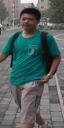

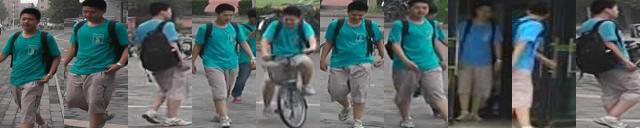

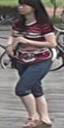

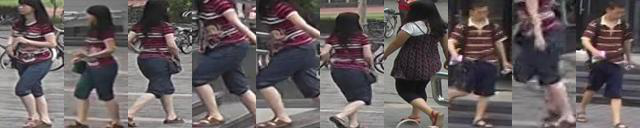

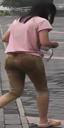

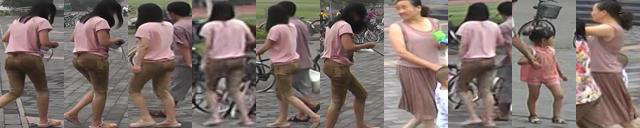

In [25]:
check_reid_output(reid_output_file, n_queries=3)

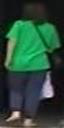

Attributes predicted
age         :  2
backpack    :  1
bag         :  1
handbag     :  1
clothes     :  2
down        :  1
up          :  2
hair        :  2
hat         :  1
gender      :  2
upblack     :  1
upwhite     :  1
upred       :  1
uppurple    :  1
upyellow    :  1
upgray      :  1
upblue      :  1
upgreen     :  2
downblack   :  2
downwhite   :  1
downpink    :  1
downpurple  :  1
downyellow  :  1
downgray    :  1
downblue    :  1
downgreen   :  1
downbrown   :  1


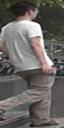

Attributes predicted
age         :  2
backpack    :  1
bag         :  1
handbag     :  1
clothes     :  2
down        :  1
up          :  2
hair        :  1
hat         :  1
gender      :  1
upblack     :  1
upwhite     :  1
upred       :  1
uppurple    :  1
upyellow    :  1
upgray      :  2
upblue      :  1
upgreen     :  1
downblack   :  1
downwhite   :  1
downpink    :  1
downpurple  :  1
downyellow  :  1
downgray    :  2
downblue    :  1
downgreen   :  1
downbrown   :  1


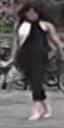

Attributes predicted
age         :  2
backpack    :  2
bag         :  1
handbag     :  1
clothes     :  2
down        :  2
up          :  2
hair        :  2
hat         :  1
gender      :  2
upblack     :  2
upwhite     :  1
upred       :  1
uppurple    :  1
upyellow    :  1
upgray      :  1
upblue      :  1
upgreen     :  1
downblack   :  2
downwhite   :  1
downpink    :  1
downpurple  :  1
downyellow  :  1
downgray    :  1
downblue    :  1
downgreen   :  1
downbrown   :  1


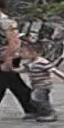

Attributes predicted
age         :  3
backpack    :  1
bag         :  1
handbag     :  1
clothes     :  2
down        :  1
up          :  2
hair        :  1
hat         :  1
gender      :  2
upblack     :  1
upwhite     :  1
upred       :  1
uppurple    :  1
upyellow    :  1
upgray      :  1
upblue      :  1
upgreen     :  1
downblack   :  2
downwhite   :  1
downpink    :  1
downpurple  :  1
downyellow  :  1
downgray    :  1
downblue    :  1
downgreen   :  1
downbrown   :  1


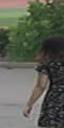

Attributes predicted
age         :  3
backpack    :  1
bag         :  1
handbag     :  1
clothes     :  1
down        :  2
up          :  2
hair        :  2
hat         :  1
gender      :  2
upblack     :  2
upwhite     :  1
upred       :  1
uppurple    :  1
upyellow    :  1
upgray      :  1
upblue      :  1
upgreen     :  1
downblack   :  1
downwhite   :  1
downpink    :  1
downpurple  :  1
downyellow  :  1
downgray    :  1
downblue    :  1
downgreen   :  1
downbrown   :  1


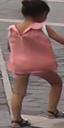

Attributes predicted
age         :  2
backpack    :  1
bag         :  1
handbag     :  1
clothes     :  1
down        :  2
up          :  2
hair        :  2
hat         :  1
gender      :  2
upblack     :  1
upwhite     :  1
upred       :  2
uppurple    :  1
upyellow    :  1
upgray      :  1
upblue      :  1
upgreen     :  1
downblack   :  1
downwhite   :  1
downpink    :  2
downpurple  :  1
downyellow  :  1
downgray    :  1
downblue    :  1
downgreen   :  1
downbrown   :  1


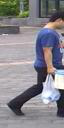

Attributes predicted
age         :  2
backpack    :  1
bag         :  1
handbag     :  1
clothes     :  2
down        :  1
up          :  2
hair        :  1
hat         :  1
gender      :  1
upblack     :  1
upwhite     :  1
upred       :  1
uppurple    :  1
upyellow    :  1
upgray      :  1
upblue      :  2
upgreen     :  1
downblack   :  2
downwhite   :  1
downpink    :  1
downpurple  :  1
downyellow  :  1
downgray    :  1
downblue    :  1
downgreen   :  1
downbrown   :  1


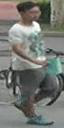

Attributes predicted
age         :  2
backpack    :  1
bag         :  1
handbag     :  1
clothes     :  2
down        :  2
up          :  2
hair        :  1
hat         :  1
gender      :  1
upblack     :  1
upwhite     :  2
upred       :  1
uppurple    :  1
upyellow    :  1
upgray      :  1
upblue      :  1
upgreen     :  1
downblack   :  1
downwhite   :  1
downpink    :  1
downpurple  :  1
downyellow  :  1
downgray    :  2
downblue    :  1
downgreen   :  1
downbrown   :  1


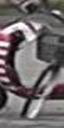

Attributes predicted
age         :  2
backpack    :  1
bag         :  1
handbag     :  1
clothes     :  2
down        :  1
up          :  2
hair        :  1
hat         :  1
gender      :  2
upblack     :  1
upwhite     :  2
upred       :  1
uppurple    :  1
upyellow    :  1
upgray      :  1
upblue      :  1
upgreen     :  1
downblack   :  2
downwhite   :  1
downpink    :  1
downpurple  :  1
downyellow  :  1
downgray    :  1
downblue    :  1
downgreen   :  1
downbrown   :  1


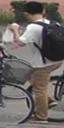

Attributes predicted
age         :  2
backpack    :  2
bag         :  1
handbag     :  1
clothes     :  2
down        :  2
up          :  2
hair        :  1
hat         :  1
gender      :  1
upblack     :  1
upwhite     :  2
upred       :  1
uppurple    :  1
upyellow    :  1
upgray      :  1
upblue      :  1
upgreen     :  1
downblack   :  1
downwhite   :  1
downpink    :  1
downpurple  :  1
downyellow  :  1
downgray    :  1
downblue    :  1
downgreen   :  1
downbrown   :  2


In [48]:
check_ar_output(ar_output_file, n_img=10)